<img src="../assets/blocks_animation_v3.gif" align="center" width="100%" margin="0" ></img> 
<br>

# `DEMOLITION PREMONITION`
# - 
##### `by Samuel He`
---
## 04 Data Cleaning / EDA / Feature Engineering Part 2
---


In [1]:
# MUST-HAVE LIBRARIES
import time
from random import randint
from random import randint
import datetime as dt
import matplotlib.pyplot as plt
from matplotlib.lines import Line2D
import pandas as pd
import seaborn as sns
import numpy as np
%matplotlib inline
from statistics import mean 
#%config InlineBackend.figure_format = 'svg' # Magic to create Hi-Res PLT Plots

# REGEX
import re
import string

# GEOSPATIAL LIBRARIES
import geopy
from geopy.distance import lonlat, distance, geodesic
from math import sin, cos, sqrt, atan2, radians
import geopandas as gpd
from geopandas import GeoSeries, GeoDataFrame
import shapely
from shapely import geometry
from shapely import ops
from shapely.geometry import Point, LineString, Polygon, MultiPoint, shape,mapping
from shapely.ops import nearest_points
from shapely.geometry import Point
import mplleaflet
import contextily as ctx
#import utm
from pyproj import Proj
from onemapsg import OneMapClient #We'll use this to convert coordinates

#Uncomment to download GIS libraries
#!pip3 install --upgrade --target=/Users/samuelhe/opt/anaconda3/lib/python3.7/site-packages geopandas
#!pip3 install --upgrade --target=/Users/samuelhe/opt/anaconda3/lib/python3.7/site-packages git+git://github.com/jwass/mplleaflet.git
#conda install mplleaflet
#Uncomment to download imblearn
#!pip3 install --upgrade --target=/Users/samuelhe/opt/anaconda3/lib/python3.7/site-packages imblearn


In [2]:
# DEFINING MAP BACKGROUND TILE OPTIONS FROM THE CONTEXTILY LIBRARY

ST_TONER = 'http://tile.stamen.com/toner/tileZ/tileX/tileY.png'
ST_TONER_HYBRID = 'http://tile.stamen.com/toner-hybrid/tileZ/tileX/tileY.png'
ST_TONER_LABELS = 'http://tile.stamen.com/toner-labels/tileZ/tileX/tileY.png'
ST_TONER_LINES = 'http://tile.stamen.com/toner-lines/tileZ/tileX/tileY.png'
ST_TONER_BACKGROUND = 'http://tile.stamen.com/toner-background/tileZ/tileX/tileY.png'
ST_TONER_LITE = 'http://tile.stamen.com/toner-lite/tileZ/tileX/tileY.png'
ST_TERRAIN = 'http://tile.stamen.com/terrain/tileZ/tileX/tileY.png'
ST_TERRAIN_LABELS = 'http://tile.stamen.com/terrain-labels/tileZ/tileX/tileY.png'
ST_TERRAIN_LINES = 'http://tile.stamen.com/terrain-lines/tileZ/tileX/tileY.png'
ST_TERRAIN_BACKGROUND = 'http://tile.stamen.com/terrain-background/tileZ/tileX/tileY.png'
ST_WATERCOLOR = 'http://tile.stamen.com/watercolor/tileZ/tileX/tileY.png'

# OPEN STREET MAPS AS AN ALTERNATIVE

OSM_A = 'http://a.tile.openstreetmap.org/tileZ/tileX/tileY.png'
OSM_B = 'http://b.tile.openstreetmap.org/tileZ/tileX/tileY.png'
OSM_C = 'http://c.tile.openstreetmap.org/tileZ/tileX/tileY.png'

In [3]:
#READING IN CSVs
demo_blocks_carparks = pd.read_csv("../data/demo_blocks_carparks_22_apr_11am.csv")
stand_blocks_carparks = pd.read_csv("../data/stand_blocks_carparks_22_apr_11am.csv")


### 4.1 Building a Training Set and Unseen Test Set
As we ready our data for modelling. We're going to prepare two sets of data:

> **Pre-1987 Blocks**: As the youngest block to be demolished so far was in 1986. Our training set will be all the blocks that Singapore has built before 1987. This allows our classifier to ask accurate questions about blocks in that generation. 

> **Post-1986 Blocks**: The blocks in our second dataset will all be standing blocks built after 1986. Our trained model will aim to predict which blocks will come next. 

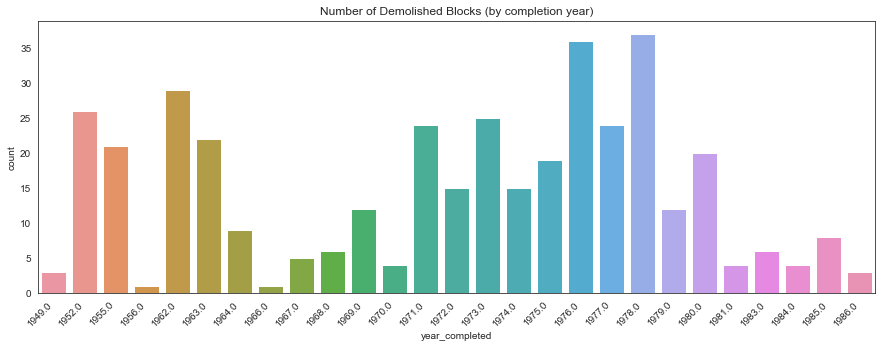

In [304]:
# THE YOUNGEST BLOCK TO BE DEMOLISHED SO FAR WAS IN 1986.
plt.figure(figsize=(15,5))
plt.title("Number of Demolished Blocks (by completion year)")
chart = sns.countplot(demo_blocks_carparks["year_completed"]);
chart.set_xticklabels(chart.get_xticklabels(), rotation=45, horizontalalignment='right');

In [5]:
# CREATING A DF WITH ONLY STANDING BLOCKS BUILT BEFORE 1987
before_1987 = stand_blocks_carparks["year_completed"]<1987
# CHECKING SHAPE OF THIS DF
print(stand_blocks_carparks[before_1987].shape)
stand_blocks_pre1987 = stand_blocks_carparks[before_1987]
stand_blocks_pre1987.tail()

(4116, 26)


,latest_survival_date,year_completed,blk_no,street,max_floor_lvl,bldg_contract_town,total_dwelling_units,1room_sold,2room_sold,3room_sold,...,longitude,car_park_no,car_park_type,type_of_parking_system,short_term_parking,free_parking,night_parking,car_park_decks,gantry_height,car_park_basement
4733,2020-04-24,1986,835,woodlands st 83,12,wl,65,0,0,12,...,103.791055,w39,surface car park,electronic parking,7am-10.30pm,sun & ph fr 7am-10.30pm,no,0,4.5,n
4738,2020-04-24,1986,312,yishun ring rd,12,ys,132,0,0,0,...,103.841457,y41,surface car park,electronic parking,whole day,sun & ph fr 7am-10.30pm,yes,0,0.0,n
4739,2020-04-24,1986,311,yishun ring rd,12,ys,132,0,0,0,...,103.840815,y41,surface car park,electronic parking,whole day,sun & ph fr 7am-10.30pm,yes,0,0.0,n
4740,2020-04-24,1986,304,yishun ctrl,12,ys,110,0,0,66,...,103.840307,y41,surface car park,electronic parking,whole day,sun & ph fr 7am-10.30pm,yes,0,0.0,n
4741,2020-04-24,1986,303,yishun ctrl,12,ys,110,0,0,66,...,103.840067,y41,surface car park,electronic parking,whole day,sun & ph fr 7am-10.30pm,yes,0,0.0,n


In [6]:
# CREATING OUR TRAINING SET
blocks_pre1987 = pd.concat([demo_blocks_carparks, stand_blocks_pre1987], axis="rows")

In [7]:
# DROP stand_blocks_pre1984 ROWS FROM stand_blocks_carparks
# INDICES TO DROP
indices_to_drop = stand_blocks_carparks[before_1987].index.tolist()

In [8]:
# DROP THE BLOCKS WE ADDED TO blocks_pre1987 TO FORM OUR UNSEEN DATASET
blocks_post1986 = stand_blocks_carparks.drop(indices_to_drop, axis="rows")
# CHECKING FINAL SHAPE - SHOULD BE (5849,35)
blocks_post1986.shape

(5849, 26)

In [9]:
# RENAMING COLUMNS
blocks_post1986.rename(columns={'car_park_no': "cp_code", "car_park_type": "cp_type",
                                "type_of_parking_system": "cp_system", "short_term_parking": "cp_short_term",
                                "free_parking": "cp_free", "night_parking": "cp_night",
                                "car_park_decks": "cp_decks", "gantry_height": "cp_gantry_height",
                                "car_park_basement": "cp_basement"
                               }, inplace=True)

blocks_pre1987.rename(columns={'car_park_no': "cp_code", "car_park_type": "cp_type",
                                "type_of_parking_system": "cp_system", "short_term_parking": "cp_short_term",
                                "free_parking": "cp_free", "night_parking": "cp_night",
                                "car_park_decks": "cp_decks", "gantry_height": "cp_gantry_height",
                                "car_park_basement": "cp_basement"
                               }, inplace=True)

### Conclusion: Done!!

> **blocks_pre1987**: Our Training Set.

> **blocks_post1986**: Our Unseen Test Set.

### 4.2 Looking at correlation in our features

In [10]:
# CREATING A DATAFRAME WITH EVERY SINGLE BLOCK (BOTH STANDING AND DEMOLISHED)
all_blocks = pd.concat([blocks_pre1987, blocks_post1986], axis="rows")

In [11]:
# DESCRIBING THE DATASET
all_blocks.describe()

,year_completed,max_floor_lvl,total_dwelling_units,1room_sold,2room_sold,3room_sold,4room_sold,5room_sold,exec_sold,other_sold,is_demolished,latitude,longitude,cp_decks,cp_gantry_height
count,10356.000000,10356.000000,10356.000000,10356.000000,10356.000000,10356.000000,10356.000000,10356.000000,10356.000000,10356.000000,10356.000000,10356.000000,10356.000000,10356.000000,10356.000000
mean,1990.701429,13.838837,106.861240,0.072905,2.481943,25.866261,41.595500,23.559965,6.276844,7.007822,0.037756,1.363984,103.839532,4.607860,2.767740
std,13.719888,6.027556,56.403521,3.893611,13.703100,50.155128,41.378274,31.088876,18.950425,40.547711,0.190615,0.042693,0.073177,5.382703,2.061992
min,1937.000000,2.000000,2.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,1.270380,103.685228,0.000000,0.000000
25%,1983.000000,11.000000,78.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,1.335747,103.774584,0.000000,2.000000
50%,1988.000000,13.000000,100.000000,0.000000,0.000000,0.000000,34.000000,1.000000,0.000000,0.000000,0.000000,1.361027,103.844499,0.000000,2.150000
75%,1999.000000,16.000000,130.000000,0.000000,0.000000,30.000000,65.000000,44.000000,0.000000,0.000000,0.000000,1.390534,103.897751,10.000000,4.500000
max,2019.000000,50.000000,584.000000,255.000000,225.000000,528.000000,316.000000,164.000000,135.000000,520.000000,1.000000,1.456658,103.987805,19.000000,9.990000


/Users/samuelhe/opt/anaconda3/lib/python3.7/site-packages/seaborn/axisgrid.py:2079: UserWarning: The `size` parameter has been renamed to `height`; please update your code.
  warnings.warn(msg, UserWarning)


<Figure size 360x360 with 0 Axes>

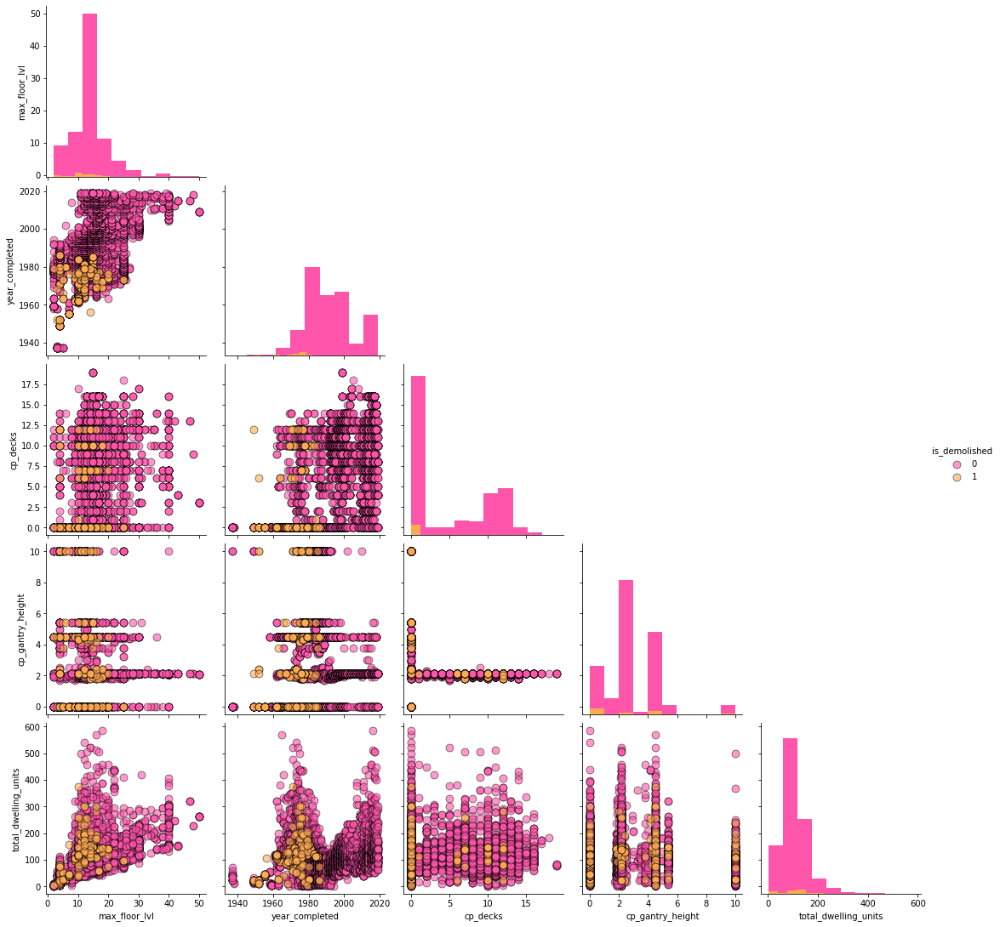

In [12]:
# ISOLATING COLUMNS WE WANT TO EXPLORE
explore_heights = ['max_floor_lvl',"year_completed", 'cp_decks', 
                   'cp_gantry_height', "total_dwelling_units",
                   "is_demolished"]

# CREATING A PAIRPLOT TO COMPARE SELECTED COLUMNS
g = plt.figure(figsize=(5,5));

g = sns.pairplot(all_blocks[explore_heights], 
                 hue="is_demolished",diag_kind = 'hist',
                 plot_kws = {'alpha': 0.6, 's': 80, 'edgecolor': 'k'},
                 size = 3, palette= "spring"); #


# HIDING THE TOP HALF OF THE PAIRPLOT
def hide_current_axis(*args, **kwds):
    plt.gca().set_visible(False)
    
g.map_upper(hide_current_axis);


<Figure size 1440x1440 with 0 Axes>

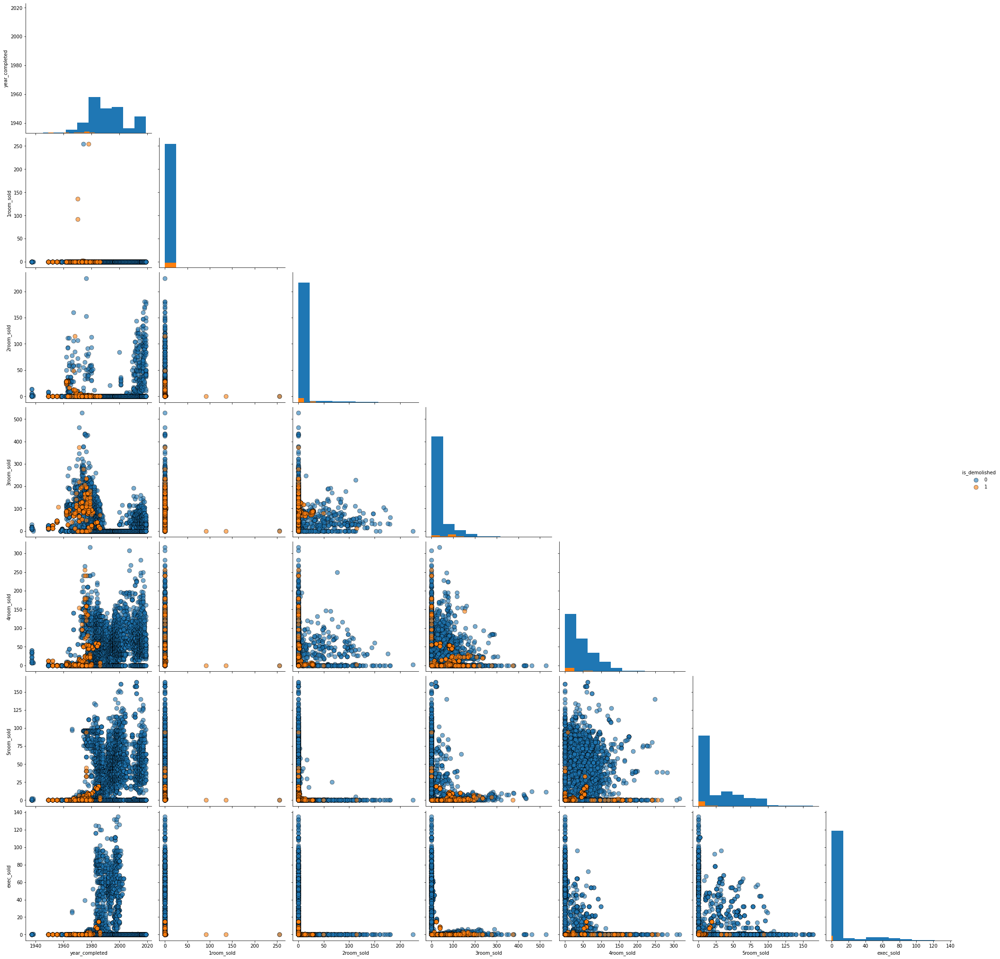

In [13]:
# ISOLATING COLUMNS WE WANT TO EXPLORE
explore_rooms = ["year_completed", '1room_sold', '2room_sold', 
                 '3room_sold', '4room_sold','5room_sold',
                 'exec_sold',"is_demolished"]
# CREATING A PAIRPLOT TO COMPARE SELECTED COLUMNS
g = plt.figure(figsize=(20,20));

g = sns.pairplot(all_blocks[explore_rooms], 
                 hue="is_demolished",diag_kind = 'hist',
                 plot_kws = {'alpha': 0.6, 's': 80, 'edgecolor': 'k'},
                 size = 4); 
# HIDING THE TOP HALF OF THE PAIRPLOT
def hide_current_axis(*args, **kwds):
    plt.gca().set_visible(False)
    
g.map_upper(hide_current_axis);

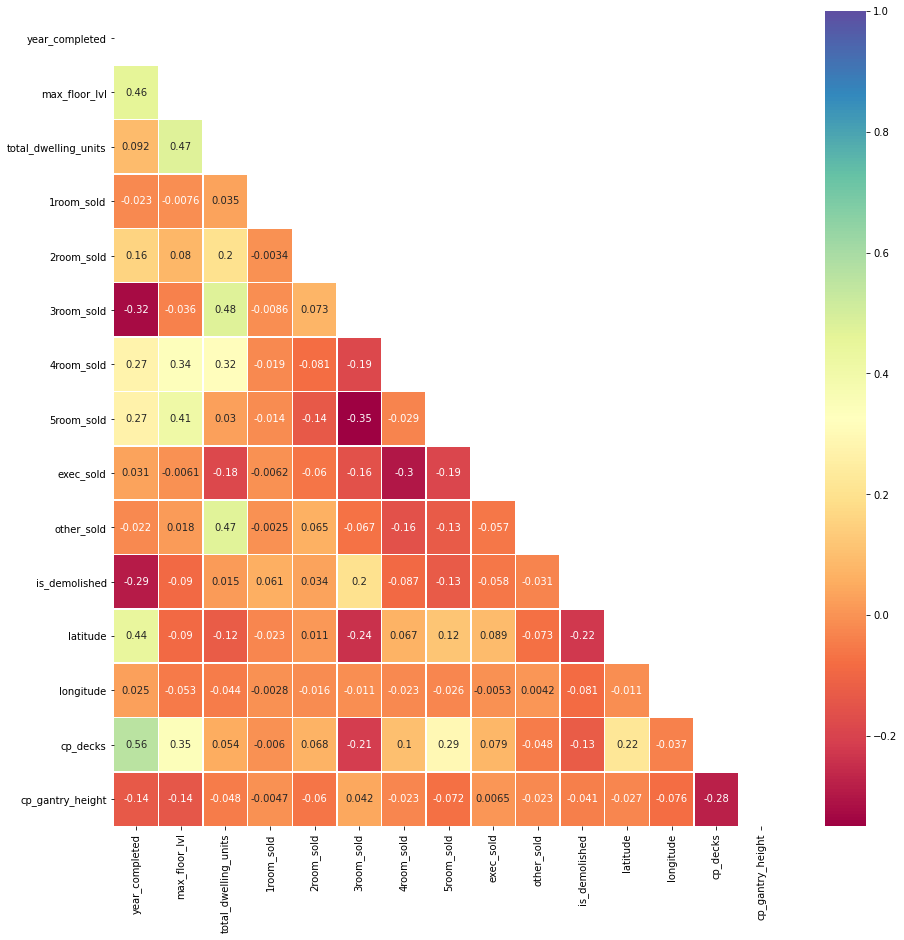

In [23]:

plt.figure(figsize=(15, 15))
mask = np.zeros_like(all_blocks.corr(), dtype=np.bool)
mask[np.triu_indices_from(mask)] = True
sns.heatmap(all_blocks.corr(), mask=mask, cmap="Spectral", annot=True, linewidths=.5);



### Analysis from Pairplots

> **Executive flats no more?** - Executive flats seem to be something that was built from the 1980s to early 2000s. These flats are bigger flats (about 130 square metres) that the HDB says has *a balcony space for added alfresco enjoyment*. More information about public housing flat types can be found [here](https://www.hdb.gov.sg/cs/infoweb/residential/buying-a-flat/resale/types-of-flats). 

> **Newer blocks = Taller blocks** - Obviously, Singapore being land-scarse, needs to built taller and more space-efficient blocks. Our data reflects that. We can see that Singapore only got its first 40-storey HDB flats after 2000. Interestingly, there's still a fair number of "short" blocks (under 10 floors) built in the past ten years. These taller blocks seem to consist of more four and five-room units. This might signal a trend for flats moving forward. 

> **Building Booms!** - There were big public housing booms during two periods, in the early 1980s and the late 1990s. In the past ten years, public housing projects seems to have picked up again. 

> **From three rooms to two** - In the past ten years there seems to be a shift towards building two-room flats. Five-room flats seems to be as "popular" ever since its inception in the eighties. 

> **One-room flats?** - There seems to be very few blocks with one-room flats "sold".

> **Possible Engineered Feature: Mega Blocks!** - Although the trend tends to point towards higher floors. There exists a fair number of blocks that are between 10 to 20 floors that have a high number of total dwelling units. This might be really long slab blocks. As we look at space-efficiency, this might be something interesting to explore. 






### 4.3 Greater Heights  - exploring public housing block heights
One reason to tear down a block is to maximise space-use by building taller blocks. Thus, it is important to look at the heights of blocks over the years and what types of barriers the government faces to building taller blocks here. 

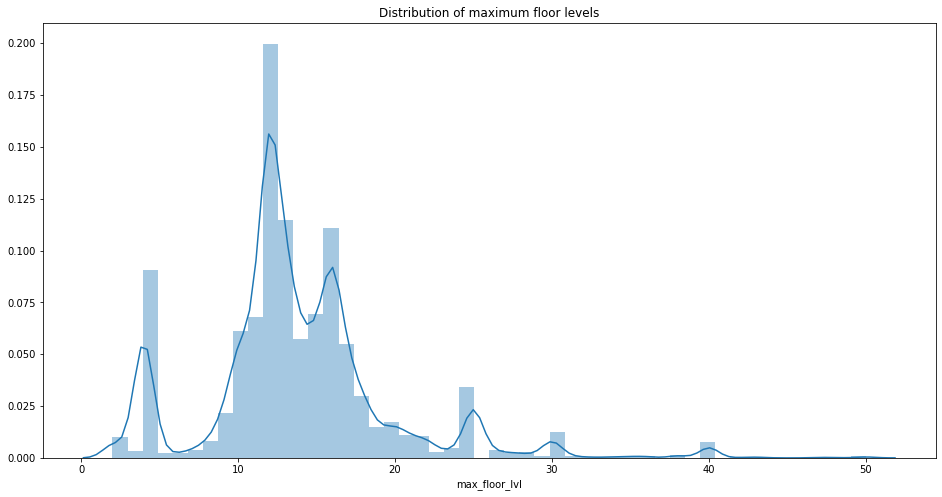

In [24]:
# CREATING A DISTRIBUTION PLOT
plt.figure(figsize=(16,8))
plt.title("Distribution of maximum floor levels")
sns.distplot(all_blocks["max_floor_lvl"]);

#### Quick Observations from the distribution of maximum floor levels

> **12-floor blocks dominate** - About 26% of all our blocks are 12-13 stories high.

> **Other common heights** - Other common "height classes" are 2-storey, 5-storey and 16-storey blocks, each consisting of about 8% of our total blocks. 

In [25]:
# CREATING A DATAFRAME WITH latlon OF SINGAPORE'S AIRFIELDS
# DETAILS FROM GOOGLE MAPS
airfields = {'airfield_name': ["changi airport", "paya lebar air base", 
                               "seletar airport", "tengah air base", 
                               "sembawang air base"], 
             'longitude': [103.9885647, 103.909444, 103.867778, 103.708611,103.812778], 
             'latitude':[1.3573382, 1.360278, 1.416944, 1.387222, 1.425278]}
airfields = pd.DataFrame(airfields)

# TRANSFORMING airfields INTO A GEOGRAPHIC DF
# CREATING A GEOMETRY COLUMN
geometry = [Point(xy) for xy in zip(airfields['longitude'], airfields['latitude'])]

# COORDINATE REFERENCE SYSTEM : WGS84
crs = {'init': 'epsg:4326'}

# CREATING A GEOGRAPHIC DF
airfields_geo = gpd.GeoDataFrame(airfields, crs=crs, geometry=geometry)

# CONVERTING OUR GEOMETRY COLUMN TO WEB MERCATOR EPSG3857...
# THE CONTEXTILY MAPS USE THIS
airfields_geo = airfields_geo.to_crs(epsg=3857).copy()

/Users/samuelhe/opt/anaconda3/lib/python3.7/site-packages/pyproj/crs/crs.py:53: FutureWarning: '+init=<authority>:<code>' syntax is deprecated. '<authority>:<code>' is the preferred initialization method. When making the change, be mindful of axis order changes: https://pyproj4.github.io/pyproj/stable/gotchas.html#axis-order-changes-in-proj-6
  return _prepare_from_string(" ".join(pjargs))


In [26]:
# CREATING A GEOGRAPHIC DF FROM all_blocks

# CREATING A GEOMETRY COLUMN
geometry = [Point(xy) for xy in zip(all_blocks['longitude'], all_blocks['latitude'])]
# COORDINATE REFERENCE SYSTEM : WGS84
crs = {'init': 'epsg:4326'}

# CREATING A GEOGRAPHIC DF 
all_blocks_geo = gpd.GeoDataFrame(all_blocks, crs=crs, geometry=geometry)

# CONVERTING OUR GEOMETRY COLUMN TO WEB MERCATOR EPSG3857...
# THE CONTEXTILY MAPS USE THIS
all_blocks_geo = all_blocks_geo.to_crs(epsg=3857).copy()

/Users/samuelhe/opt/anaconda3/lib/python3.7/site-packages/pyproj/crs/crs.py:53: FutureWarning: '+init=<authority>:<code>' syntax is deprecated. '<authority>:<code>' is the preferred initialization method. When making the change, be mindful of axis order changes: https://pyproj4.github.io/pyproj/stable/gotchas.html#axis-order-changes-in-proj-6
  return _prepare_from_string(" ".join(pjargs))


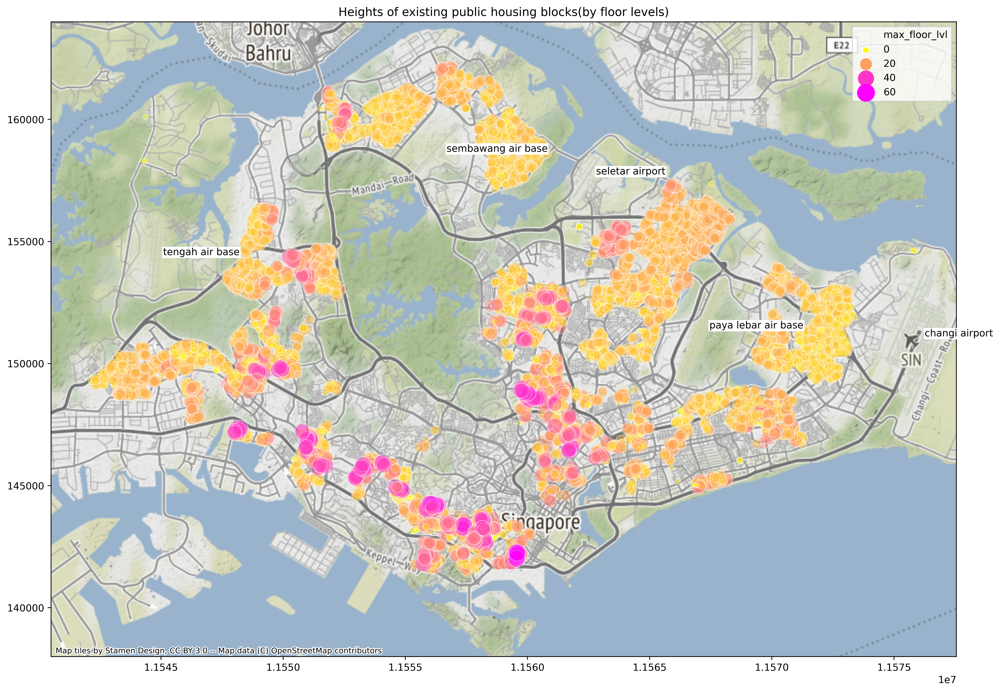

In [27]:
# PLOTTING A FIGURE TO LOOK AT THE MAXIMUM FLOOR LEVELS OF PUBLIC HOUSING BLOCKS
axis = plt.figure(figsize=(20,12), dpi=500);
plt.title("Heights of existing public housing blocks(by floor levels)")

# STANDING BLOCKS AS 12000 DOTS
axis =sns.scatterplot(all_blocks_geo['geometry'].x, all_blocks_geo['geometry'].y, marker='o', 
                hue=all_blocks_geo["max_floor_lvl"],size=all_blocks_geo["max_floor_lvl"],
               sizes=(20, 300), palette="spring_r", alpha=0.4, legend="brief");

# SETTING Y-AXIS LIMITS
axis.set_ylim([138000, 164000])
#ax.set_xlim([103.65, 104.01])

# ADDING NAMES FOR SINGAPORE'S AIRFIELDS
for i in range(airfields_geo.shape[0]):
    plt.text(airfields_geo["geometry"][i].x + 300, airfields_geo["geometry"][i].y, 
            airfields_geo["airfield_name"][i],  bbox=dict(boxstyle='square,pad=0.1', 
                                     fc='white', ec='none')) # 300m x offset added.


# ADDING A CONTEXTUAL BASE MAP 
ctx.add_basemap(axis)
#ctx.add_basemap(axis, url=ctx.sources.ST_TONER_LABELS, alpha=1) #CHOOSE TILE OPTION

#### Analysis of Block Heights

> **Taller at the South and Central areas** - Our taller housing projects(40 floors and above) are found concentrated in the South and Central areas. 

> **Aviation height restrictions** - Further East, West and North, block heights tend to be shorter(It'll be rare to spot any block higher than 20 storeys high. This is likely due to building restrictions for blocks within a certain distance to Singapore's five active airports and airbases. 

> **Paya Lebar Air Base to cease operations in 2030** - The 800ha of land that Paya Lebar sits on will be freed up for development. This also current height limit rules for the surrounding areas could be relaxed, leading to current low-rise buildings being redeveloped. It'll be great if our model can respond to Paya Lebar's relocation in 2030. More details can be found [here](https://www.straitstimes.com/singapore/a-different-paya-lebar-with-air-base-gone). 




**Engineered Feature: Distance to Nearest Airfield** 

As there is a correlation between height limits and proximity from the airfields, this could mean that the tallest blocks in these areas can't go any higher, disincentivising any plans of redevelopment. We can create a "distance from airbase" feature.

In [28]:
# CREATING A DISTANCE TO NEAREST AIRFIELD COLUMN
nearest_airfield = []
dist_to_nearest_airfield = []
num_of_blocks= all_blocks.shape[0]

for block in range(num_of_blocks):
    # CREATING A TUPLE FOR A BLOCK'S LOCATION
    block_lon = all_blocks_geo["longitude"].iloc[block]
    block_lat = all_blocks_geo["latitude"].iloc[block]
    block_location = (block_lat, block_lon)
    # EMPTY LISTS TO HOUSE OUR AIRFIELD AND DIST
    distance_list = []
    airfield_list = []
    for airfield in range(airfields_geo.shape[0]):
        af_lon = airfields_geo["longitude"].iloc[airfield]
        af_lat = airfields_geo["latitude"].iloc[airfield]
        af_location = (af_lat, af_lon)
        # MEASURING DISTANCE BETWEEN AIRFIELD AND BLOCK
        distance_btwn_locations = geopy.distance.geodesic(block_location,af_location)
        distance_list.append(distance_btwn_locations.meters)
        airfield_list.append(airfields_geo["airfield_name"].iloc[airfield])
    
    for position, distance in enumerate(distance_list):
        if distance == min(distance_list):
            dist_to_nearest_airfield.append(round(distance))
            nearest_airfield.append(airfield_list[position])
            if block%1000==0:
                print("PROGRESS: ", block+1, " / ", num_of_blocks )
                print("ADDRESS: ", all_blocks_geo["blk_no"].iloc[block], all_blocks_geo["street"].iloc[block])
                print("NEAREST AIRFIELD: ", airfield_list[position], "-", round(distance), " metres\n")
print("\n" + "*"*40)
print("COMPLETED: ", num_of_blocks, "blocks")
print("AIRFIELDS APPENDED: ", len(nearest_airfield))  
print("NEAREST DISTANCE APPENDED: ", len(dist_to_nearest_airfield), "blocks")  
print("*"*40)

PROGRESS:  1  /  10356
ADDRESS:  2 boon tiong rd / tiong bahru rd
NEAREST AIRFIELD:  paya lebar air base - 12139  metres

PROGRESS:  1001  /  10356
ADDRESS:  74 whampoa dr
NEAREST AIRFIELD:  paya lebar air base - 6968  metres

PROGRESS:  2001  /  10356
ADDRESS:  584 ang mo kio ave 3
NEAREST AIRFIELD:  seletar airport - 5353  metres

PROGRESS:  3001  /  10356
ADDRESS:  908 tampines ave 4
NEAREST AIRFIELD:  paya lebar air base - 3431  metres

PROGRESS:  4001  /  10356
ADDRESS:  408 bt batok west ave 4
NEAREST AIRFIELD:  tengah air base - 4746  metres

PROGRESS:  5001  /  10356
ADDRESS:  460 tampines st 42
NEAREST AIRFIELD:  changi airport - 3736  metres

PROGRESS:  6001  /  10356
ADDRESS:  559 hougang st 51
NEAREST AIRFIELD:  paya lebar air base - 3114  metres

PROGRESS:  7001  /  10356
ADDRESS:  786 choa chu kang dr
NEAREST AIRFIELD:  tengah air base - 4507  metres

PROGRESS:  8001  /  10356
ADDRESS:  104b depot rd
NEAREST AIRFIELD:  paya lebar air base - 13971  metres

PROGRESS:  9001 

In [29]:
# ENGINEERING TWO FEATURES TO INDICATE DISTANCE FROM CLOSEST AIRFIELD
all_blocks_geo["dist_to_airfield"] = dist_to_nearest_airfield
all_blocks_geo["airfield"] = nearest_airfield

**Engineered Feature: Height Potential and Density Score** 

We can create a height potential (or a *potential to build higher*) score by subtracting the height of our block from the average height of the all buildings within a 500 metre radius to it. While we are at it, we will also be able to create a density feature, which counts the number of blocks within that same radius. 


In [ ]:
# # REBUILDING OUR blocks_pre1984 AND blocks_post1983 DATAFRAMES
# blocks_pre1984 = all_blocks_geo[all_blocks_geo["year_completed"]<1984]
# blocks_post1983 = all_blocks_geo[all_blocks_geo["year_completed"]>1983]

In [30]:
# DEFINING A FUNCTION TO CREATE HEIGHT POTENTIAL AND DENSITY SCORE COLUMNS
# WE SHOULD HAVE THESE TWO EMPTY LISTS OUTSIDE OUR FUNCTION
height_score_list = []
density_500m_list = []

def create_height_score_density_score(df):
    
    num_of_blocks= df.shape[0]
    #LOOPING THROUGH NUMBER OF BLOCKS IN A DATASET
    for block in range(num_of_blocks):
        # CREATING A TUPLE FOR A BLOCK'S LOCATION
        block_lon = df["longitude"].iloc[block]
        block_lat = df["latitude"].iloc[block]
        block_location = (block_lat, block_lon)
        # EMPTY LISTS TO HOUSE OUR DISTANCES AND CARPARK CODES
        # TO DELETE --> distance_list = []
        max_floor_list = []
        # NESTED LOOP TO COMPARE OUR BLOCK WITH EVERY OTHER BLOCK IN THE DF
        for other_block in range(df.shape[0]):
            other_block_lon = df["longitude"].iloc[other_block]
            other_block_lat = df["latitude"].iloc[other_block]
            other_block_location = (other_block_lat, other_block_lon)
            # MEASURING DISTANCE BETWEEN TWO BLOCKS BLOCK
            distance_btwn_locations = geopy.distance.geodesic(block_location,other_block_location)
            # ONLY CHOOSING BLOCKS WITHIN A 500m RADIUS
            if distance_btwn_locations.meters <= 500 and distance_btwn_locations.meters > 0:
                # APPEND MAX FLOOR LEVELS
                max_floor_list.append(df["max_floor_lvl"].iloc[other_block])
        # CALCULATING POTENTIAL HEIGHT SCORE (current ht - avg height of surrounding blks)
        current_height = df["max_floor_lvl"].iloc[block]
        height_score = current_height-round(np.mean(max_floor_list),2)
        # APPENDING HEIGHT AND DENSITY SCORES
        height_score_list.append(height_score)
        density_500m_list.append(len(max_floor_list))
        # PRINTING A PROGRESS REPORT FOR EVERY 500 BLOCKS
        if block%500==0:
            print("PROGRESS: ", block+1, " / ", num_of_blocks )
            print("ADDRESS: ", df["blk_no"].iloc[block], df["street"].iloc[block])
            print("CURRENT HEIGHT: ", current_height, " floors")
            print("POTENTIAL HEIGHT SCORE: ", height_score)
            print("NUM OF BLOCKS WITHIN 500m RADIUS: ", len(max_floor_list))
            print("AVG HEIGHT OF BLOCKS WITHIN 1km RADIUS: ", round(np.mean(max_floor_list),2), "\n")
    # PRINT A COMPLETION REPORT
    print("\n" + "*"*40)
    print("COMPLETED: ", num_of_blocks, "blocks")
    print("NUM OF SCORES APPENDED: ", len(height_score_list))  
    print("*"*40)

In [31]:
# CREATING EMPTY LISTS TO NEST OUR VALUES
height_score_list = []
density_500m_list = []
# CALLING THE FUNCTION ON OUR blocks_pre1984
create_height_score_density_score(all_blocks_geo)

PROGRESS:  1  /  10356
ADDRESS:  2 boon tiong rd / tiong bahru rd
CURRENT HEIGHT:  4  floors
POTENTIAL HEIGHT SCORE:  -10.38
NUM OF BLOCKS WITHIN 500m RADIUS:  125
AVG HEIGHT OF BLOCKS WITHIN 1km RADIUS:  14.38 



/Users/samuelhe/opt/anaconda3/lib/python3.7/site-packages/numpy/core/fromnumeric.py:3335: RuntimeWarning: Mean of empty slice.
  out=out, **kwargs)
/Users/samuelhe/opt/anaconda3/lib/python3.7/site-packages/numpy/core/_methods.py:161: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


PROGRESS:  501  /  10356
ADDRESS:  43 stirling rd
CURRENT HEIGHT:  2  floors
POTENTIAL HEIGHT SCORE:  -8.41
NUM OF BLOCKS WITHIN 500m RADIUS:  54
AVG HEIGHT OF BLOCKS WITHIN 1km RADIUS:  10.41 

PROGRESS:  1001  /  10356
ADDRESS:  74 whampoa dr
CURRENT HEIGHT:  16  floors
POTENTIAL HEIGHT SCORE:  4.460000000000001
NUM OF BLOCKS WITHIN 500m RADIUS:  87
AVG HEIGHT OF BLOCKS WITHIN 1km RADIUS:  11.54 

PROGRESS:  1501  /  10356
ADDRESS:  339 ang mo kio ave 1
CURRENT HEIGHT:  2  floors
POTENTIAL HEIGHT SCORE:  -13.11
NUM OF BLOCKS WITHIN 500m RADIUS:  57
AVG HEIGHT OF BLOCKS WITHIN 1km RADIUS:  15.11 

PROGRESS:  2001  /  10356
ADDRESS:  584 ang mo kio ave 3
CURRENT HEIGHT:  12  floors
POTENTIAL HEIGHT SCORE:  -2.49
NUM OF BLOCKS WITHIN 500m RADIUS:  79
AVG HEIGHT OF BLOCKS WITHIN 1km RADIUS:  14.49 

PROGRESS:  2501  /  10356
ADDRESS:  107 towner rd
CURRENT HEIGHT:  25  floors
POTENTIAL HEIGHT SCORE:  6.09
NUM OF BLOCKS WITHIN 500m RADIUS:  56
AVG HEIGHT OF BLOCKS WITHIN 1km RADIUS:  18.9

In [32]:
# CREATING A height_score COLUMN
all_blocks_geo["height_score_2020"] = [round(score,2) for score in height_score_list]
# CREATING A density_500m COLUMN
all_blocks_geo["density_500m"] = density_500m_list

### What do height and density score indicate?

> **Explaining the "height_score" feature** - A highly negative score here means that a particular block can be demolished and built even higher, whereas, a highly postive score means that the block is towering above its peers(possibly meaning a new block built in its place might not be able to be built taller). We find this feature to be a lot more objective than the height of the block itself, as it takes into account some form of construction height limits in the vicinity. 

> **Limitations** - The current height score captures the height scores in the current year 2020 and does not take into account the height scores of a block at the time of its construction, which might also be useful information. We might aspire to build a *historical_height_score* feature.


> **Explaining the "density_500m" feature** -  This feature might be useful in letting our model know how "developed" or "well-used" the estate around the block is. It does have its flaws as blocks built near the vicinity of a huge park or nature reserve might suffer from a low density score even though the land might have already been adequately used. It might help our model to have other density-related features. 

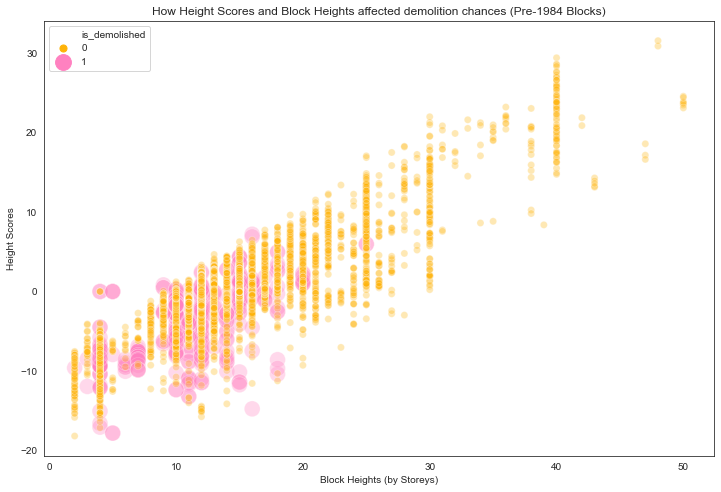

In [343]:
#CREATING A SCATTERPLOT TO ANALYSE HEIGHT SCORES
sns.set_style("white")
plt.figure(figsize = (12, 8))

colors = ["amber", "pink"]
sns.scatterplot(data =all_blocks_geo,
               y = "height_score_2020", 
               x = "max_floor_lvl",
               hue = 'is_demolished', 
               palette = sns.xkcd_palette(colors),
               size = 'is_demolished',
               marker= 'o',
               sizes=(250, 50),
               alpha=0.3);
plt.title("How Height Scores and Block Heights affected demolition chances (Pre-1984 Blocks)");
plt.xlabel("Block Heights (by Storeys)");
plt.ylabel("Height Scores");

In [66]:
# RESETTING INDEX TO EXPLORE DATA IN A CLEANER WAY
all_blocks_geo.reset_index(drop=True, inplace=True)

In [77]:
# CHECKING OUT OUTLIERS
all_blocks_geo[(all_blocks_geo["is_demolished"]==1)& (all_blocks_geo["max_floor_lvl"]>20)]

#THESE ARE UNIQUE BECAUSE ITS THE ONLY POINT BLOCKS THAT HAVE BEEN DEMOLISHED

# BUT THERES A MISTAKE. A CHECK ON THE EDGEPROP WEBSITE SHOWS THAT ONLY BLOCK 111 IS A POINT BLOCK
# IMAGES OF 113 SHOW THAT IT WAS ACTUALLY A 5 FLOOR BLOCK WITH 62 DWELLING UNITS

,latest_survival_date,year_completed,blk_no,street,max_floor_lvl,bldg_contract_town,total_dwelling_units,1room_sold,2room_sold,3room_sold,...,cp_free,cp_night,cp_decks,cp_gantry_height,cp_basement,geometry,dist_to_airfield,airfield,height_score_2020,density_500m
333,2009-11-08,1973.0,111,bt merah view,25,bm,96.0,0.0,0.0,0.0,...,sun & ph fr 7am-10.30pm,yes,0,0.0,n,POINT (11557480.356 142809.728),12916,paya lebar air base,5.96,48
334,2009-11-08,1973.0,113,bt merah view,25,bm,96.0,0.0,0.0,0.0,...,sun & ph fr 7am-10.30pm,yes,0,0.0,n,POINT (11557480.356 142809.728),12916,paya lebar air base,5.96,48


In [74]:
# IMPUTE NEW DATA FOR BLOCK 113 BUKIT MERAH VIEW
# PROPS TO EDGEPROP FOR THE IMAGES: https://www.edgeprop.sg/project/hdb/113-bukit-merah-view-14254
all_blocks_geo.loc[334, "max_floor_lvl"]=5
all_blocks_geo.loc[334, "total_dwelling_units"]=62
all_blocks_geo.loc[334, "3room_sold"]=60.0
all_blocks_geo.loc[334, "4room_sold"]=0.0
all_blocks_geo.loc[334, "5room_sold"]=2.0

In [80]:
# CHECKING OUT MEAN HEIGHT SCORES
all_blocks_geo["height_score_2020"].describe()

count    10347.000000
mean         0.052406
std          5.100704
min        -18.180000
25%         -1.810000
50%          0.210000
75%          1.730000
max         31.550000
Name: height_score_2020, dtype: float64

In [84]:
# CHECKING OUT MEAN HEIGHT SCORES FOR DEMOLISHED BLOCKS
all_blocks_geo[all_blocks_geo["is_demolished"]==1]["height_score_2020"].describe()

count    384.000000
mean      -4.025182
std        4.480833
min      -17.810000
25%       -7.630000
50%       -2.935000
75%       -0.672500
max        7.200000
Name: height_score_2020, dtype: float64

### Analysis of Height Score scatterplots

> **Safety above 8** - If we look at height scores here. The blocks that survived demolition all had a height score above 7.2. 

> **Floors matter, with the exception of one** - We found an outlier block (111 Bukit Merah View) which was actually a 25 floor point block, but it got demolished. It might be proof that height scores matter in HDB's decisions, because although the block was quite a tall one, it had a height score of 5.96, still below the safe zone of 8. 


In [94]:
# RESCU-ING AND RENAMING SOME ORPHANED "queenstowns" IN OUR DISTRICT COL
all_blocks_geo["bldg_contract_town"].replace("queenstown", "qt", inplace=True)

In [96]:
# SPLITING THE DATAFRAME AGAIN
blocks_pre1987 = all_blocks_geo[all_blocks_geo["year_completed"]<1987]
blocks_post1986 = all_blocks_geo[all_blocks_geo["year_completed"]>1986]

In [97]:
# CREATING A FUNCTION TO COMPARE A FEATURE BETWEEN DISTRICTS
def compare_districts(feature, feature_string): 
    # <<PLOT>> CREATING A PLOT FOR AVERAGE_______ IN DISTRICTS
    plt.figure(figsize = (12, 4));
    plt.title(feature_string + " of Districts")
    # DF WITH AVERAGE DENSITY FIGURES FOR blocks_pre1984
    avg_pre1987 = blocks_pre1987.groupby("bldg_contract_town").mean()[feature].reset_index().sort_values("bldg_contract_town")
    # PLOT LINE IN A DEFAULT SNS BLUE
    sns.lineplot(data=avg_pre1987 , x="bldg_contract_town" , y=feature, label="Before 1987");
    
    # DF WITH AVERAGE DENSITY FIGURES FOR blocks_post1983
    avg_post1986 = blocks_post1986.groupby("bldg_contract_town").mean()[feature].reset_index()
    # EXCLUDE NEW DISTRICTS THAT DID NOT EXIST PRE 1984
    exclude_new_districts = avg_post1986["bldg_contract_town"].isin(blocks_pre1987["bldg_contract_town"])
    avg_post1986 = avg_post1986[exclude_new_districts].sort_values("bldg_contract_town")
    # PLOT LINE PLOT IN PINK
    sns.lineplot(data=avg_post1986 , x="bldg_contract_town" , y=feature, color="pink", label="After 1986");
    # SETTING AXIS LABELS
    plt.xlabel("Districts");
    plt.ylabel(feature_string);

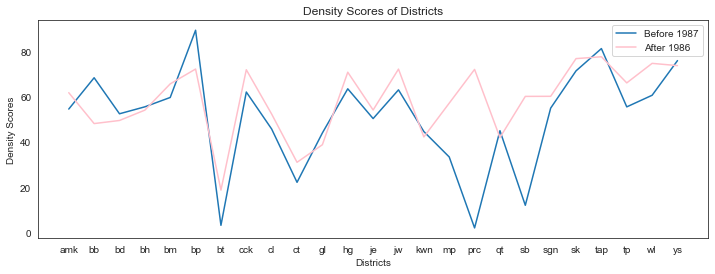

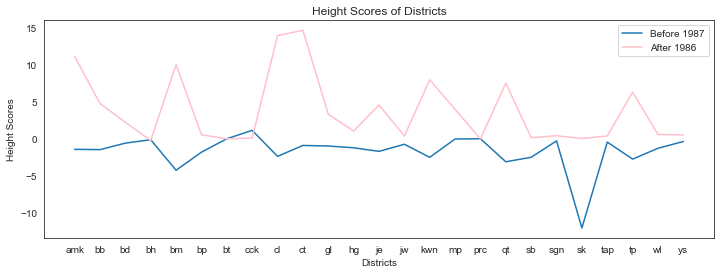

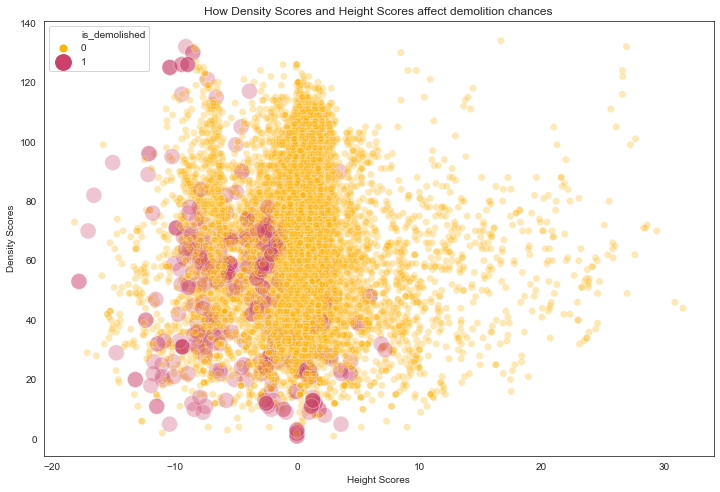

In [98]:
# <<PLOT 1>> CREATING A PLOT FOR AVERAGE DENSITY SCORES 
compare_districts("density_500m", "Density Scores")
# <<PLOT 2>> CREATING A PLOT FOR AVERAGE HEIGHT SCORES 
compare_districts("height_score_2020", "Height Scores")


#<<PLOT 3>> CREATING A SCATTERPLOT TO ANALYSE DENSITY SCORES AGAINST HEIGHT SCORES
sns.set_style("white")
plt.figure(figsize = (12, 8))
colors = ["amber", "dark pink", ]
sns.scatterplot(data =all_blocks_geo.sort_values("bldg_contract_town"),
               y = "density_500m", 
               x = "height_score_2020",
               hue = 'is_demolished', 
               palette = sns.xkcd_palette(colors),
               size = 'is_demolished',
               marker= 'o',
               sizes=(250, 50),
               alpha=0.3);
# SETTING TITLES AND AXIS LABELS
plt.title("How Density Scores and Height Scores affect demolition chances");
plt.xlabel("Height Scores");
plt.ylabel("Density Scores");

### Analysis of Height Scores and Density Scores

> **Looking at average height scores by districts** - In most districts where there is continued development, heights scores have increased. This means that buildings are maximizing their height potential. The exceptional leaps in height scores in Central and Clementi are probably due to extremely tall buildings being built in the area(The former is not very dense with public housing as it is near the CBD. The height scores jumped exponentially because of one particular 50-storey public housing development: "Pinnacle@Duxton").  

> **Looking at density scores by districts** - As we calculated density scores based on all the blocks in our dataset. the scores are largely the same within a district and its more worthwhile to compare between districts here. A noteworthy outlier here is the low density figures in Bukit Timah(bt). This is due to the area being close to clusters of private housing and the nature reserve.

> **Density Score vs Height Scores** - There does not seem to be a clear relationship between the two scores. Also, density scores seem like a poor predictor of whether a block gets demolished or not. 


---

### 4.4 Old is Gold?

Until a recent [announcement](https://www.straitstimes.com/singapore/housing/dont-assume-all-old-hdb-flats-will-become-eligible-for-sers-cautions-lawrence-wong) by the government, there was an assumption that all HDB blocks will naturally be demolished and redeveloped before the 99-year lease is up. It is still worthwhile to take a closer look at the ages of our existing blocks.


In [99]:
# RENAMING OUR all_blocks DF
all_blocks_new = all_blocks_geo.copy()

In [100]:
estates_geo = pd.read_csv("../data/estates_geo_15_apr_10pm.csv")

# CREATING A GEOMETRY COLUMN
geometry = [Point(xy) for xy in zip(estates_geo["longitude"], estates_geo["latitude"])]

# COORDINATE REFERENCE SYSTEM : WGS84
crs = {'init': 'epsg:4326'}

# CREATING A GEOGRAPHIC DF
estates_geo = gpd.GeoDataFrame(estates_geo, crs=crs, geometry=geometry)
# CREATING A GEODATAFRAME
estates_geo = estates_geo.to_crs(epsg=3857)
estates_geo = estates_geo.sort_values("year_completed")

/Users/samuelhe/opt/anaconda3/lib/python3.7/site-packages/pyproj/crs/crs.py:53: FutureWarning: '+init=<authority>:<code>' syntax is deprecated. '<authority>:<code>' is the preferred initialization method. When making the change, be mindful of axis order changes: https://pyproj4.github.io/pyproj/stable/gotchas.html#axis-order-changes-in-proj-6
  return _prepare_from_string(" ".join(pjargs))


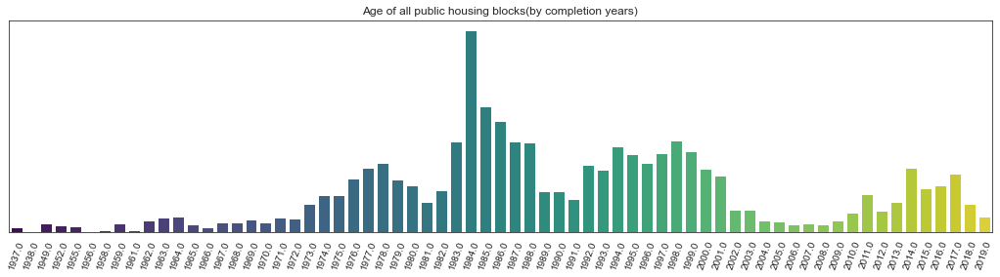

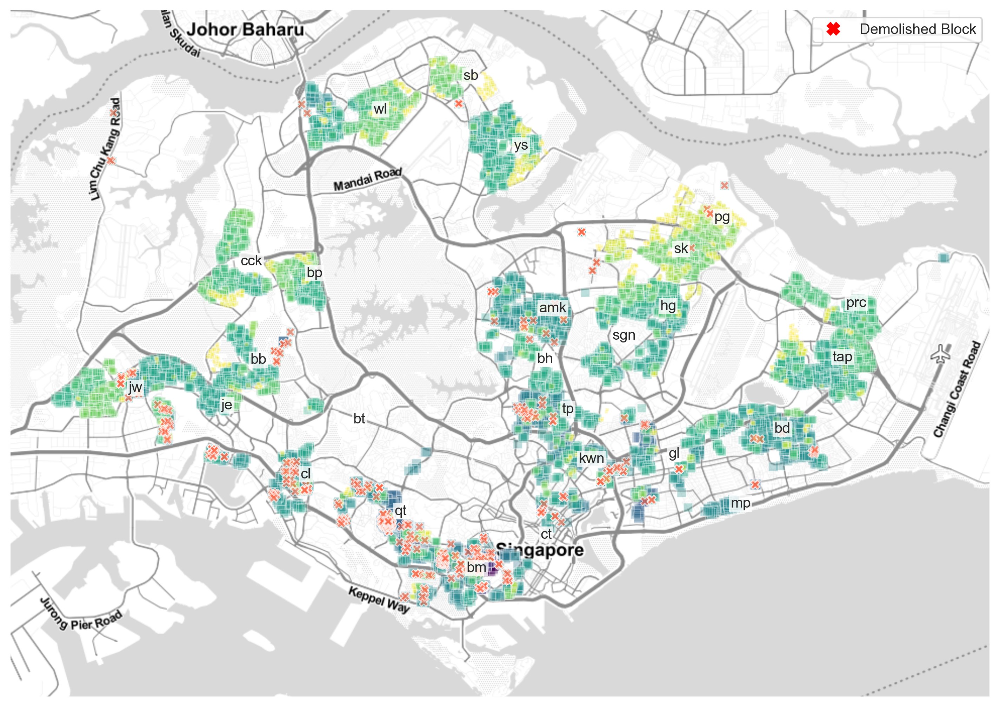

In [341]:
# <<AGE OF PUBLIC HOUSING BLOCKS>>
# CREATING A DATAFRAME OF BLOCK COUNTS BY COMPLETION YEARS
blocks_by_year = pd.DataFrame(all_blocks_new["year_completed"].value_counts(ascending=False)).reset_index()
blocks_by_year.columns=["completion_year", "count"]
# CREATING A DATAFRAME WITH ONLY DEMOLISHED BLOCKS
demo_only = all_blocks_new[all_blocks_new["is_demolished"]==1]

# CREATING A DATAFRAME OF DEMO BLOCK COUNTS BY COMPLETION YEARS
demo_blocks_by_year = pd.DataFrame(demo_only["year_completed"].value_counts(ascending=False)).reset_index()
demo_blocks_by_year.columns=["completion_year", "count"]


# <<PLOT 1: BARPLOT>> 
g = plt.figure(figsize=(18,4))
plt.title("Age of all public housing blocks(by completion years)")
g = sns.barplot("completion_year", "count", data=blocks_by_year, palette="viridis")
#g1=sns.barplot("completion_year", "count", data=demo_blocks_by_year, palette="Reds")
plt.xticks(rotation=70);
g.set(yticks=[])
g.set(ylabel=None)
g.set(xlabel=None)

# <<PLOT 2: GEO SCATTERPLOT>> 
axis = plt.figure(figsize=(12,10), dpi=300);
# NOTE: ['geometry'].x PULLS OUT THE FIRST VALUE OF THE POINT OBJECT
axis =sns.scatterplot(all_blocks_new['geometry'].x, all_blocks_new['geometry'].y, marker='s', 
                hue=all_blocks_new["year_completed"],size=all_blocks_new["year_completed"],
               sizes=(70, 5), palette="viridis", alpha=0.3, legend=None);
# DEMOLISHED BLOCKS AS 188 RED CROSSES
sns.scatterplot(demo_only['geometry'].x, demo_only['geometry'].y, marker='X', 
               sizes=(300), palette="Reds", alpha=0.6, legend=None, 
                hue=demo_only['is_demolished']);
# ADDING NAMES FOR SINGAPORE'S ESTATES
for i in range(estates_geo.shape[0]):
    plt.text(estates_geo["geometry"][i].x + 300, estates_geo["geometry"][i].y, 
            estates_geo["bldg_contract_town"][i],  bbox=dict(boxstyle='square,pad=0.1', 
                                     fc='white', ec='none', alpha=0.8)) # 300m x offset added.


# SETTING Y-AXIS LIMITS
axis.set_ylim([138000, 164000])
axis.set_frame_on(False) 
axis.set(yticks=[])
axis.set(xticks=[])
# CUSTOM LEGEND
legend_elements=[
                 Line2D([0],[0],marker='X', color='red', label='Demolished Block',linestyle='', markersize=8),
                 ]

plt.legend(handles=legend_elements, loc='upper right', fontsize=10)

# ADDING A CONTEXTUAL BASE MAP 
#ctx.add_basemap(axis,alpha=0.5)
ctx.add_basemap(axis, url=ctx.sources.ST_TONER_LITE, alpha=1, cmap="gray") #CHOOSE TILE OPTION

### Analysis of Block Ages

> **Northern Frontiers** - We can see that our newest districts are at the northern parts of the island -- in Sengkang, Punggol and Eastern Yishun. No surprises that the demolished blocks all come from older estates. 

> **Dominant 80s and 90s** - In the earlier parts of our EDA, we spotted building booms in the 80s and 90s. We can see buildings from that generation(orange squares) dominanting our map.  

---

### 4.5 Case Study: Bukit Merah
The neighbouring districts of Bukit Merah and Queenstown have the a combined 186 demolished blocks between them(More than a quarter of Singapore's demolished blocks). 

In [125]:
all_blocks_new[all_blocks_new["is_demolished"]==1].groupby("bldg_contract_town")["is_demolished"].value_counts().sort_values(ascending=False)

bldg_contract_town  is_demolished
bm                  1                98
qt                  1                88
jw                  1                33
cl                  1                27
ct                  1                23
tp                  1                18
je                  1                18
amk                 1                17
gl                  1                15
bb                  1                12
bd                  1                11
kwn                 1                10
ys                  1                 9
sk                  1                 5
sb                  1                 5
wl                  1                 2
Name: is_demolished, dtype: int64

In [456]:
# DEFINING A FUNCTION TO COMPARE A PARTICULAR FEATURE WITHIN A DISTRICT
def district_comparison(district_name, district_code, dataframe, 
                        comparison_feature, hue, map_style,
                        figsize):    
    
    # CREATING A DATAFRAME OF BLOCK COUNTS BY FEATURE
    district_blocks = dataframe[dataframe["bldg_contract_town"]==district_code]
    blocks_by_year = pd.DataFrame(district_blocks[comparison_feature].value_counts(ascending=False)).reset_index()
    blocks_by_year.columns=[comparison_feature, "count"]
    # CREATING A DATAFRAME WITH ONLY DEMOLISHED BLOCKS
    demo_only = district_blocks[district_blocks[hue]==1]

    # <<PLOT 1: BARPLOT>> 
    g = plt.figure(figsize=(18,3))
    plt.title("Visualising demolition activity in "+ district_name + " (by "+comparison_feature+")")
    g = sns.barplot(comparison_feature, "count", data=blocks_by_year, palette="viridis")
    plt.xticks(rotation=70);
    g.set(yticks=[])
    g.set(ylabel=None)
    g.set(xlabel=None)

    # <<PLOT 2: GEO SCATTERPLOT>> 
    axis = plt.figure(figsize=figsize, dpi=300);
    # NOTE: ['geometry'].x PULLS OUT THE FIRST VALUE OF THE POINT OBJECT
    axis =sns.scatterplot(district_blocks['geometry'].x, district_blocks['geometry'].y, marker='s', 
                    hue=district_blocks[comparison_feature],size=district_blocks[comparison_feature],
                   sizes=(150, 85), palette="viridis", alpha=0.9, legend=None);
    # DEMOLISHED BLOCKS 
    sns.scatterplot(demo_only['geometry'].x, demo_only['geometry'].y, marker='X', 
                   sizes=(100, 120), palette="Reds", alpha=0.9, legend=None, size=demo_only[hue],
                    hue=demo_only[hue]);

    # ADDING DESCRIPTIVE TEXT FOR CERTAIN CLUSTERS 
    cluster_list = [("redhill cl",
                      "Large vacated cluster of blocks. \nRecently used as temp homes for \nmigrant workers during covid crisis"),
                    ("boon tiong rd / tiong bahru rd", 
                      "Cluster has been torn down\n and redeveloped as some of the most \nexpensive HDB flats in the district"),
                    ("silat walk / kg bahru hill / silat rd",
                      "Quaint neighbourhood of short blocks. \nFive of these have now been gazetted for conservation")]
    
    for item in cluster_list:
        x_coord = demo_only[demo_only["street"]==item[0]]["geometry"].iloc[0].x
        y_coord = demo_only[demo_only["street"]==item[0]]["geometry"].iloc[0].y
        demo_announced = demo_only[demo_only["street"]==item[0]]["latest_survival_date"].iloc[0]
        num_of_flats = demo_clusters.loc[item[0]]["year_completed"]["count"]
        year_built = demo_clusters.loc[item[0]]["year_completed"]["mean"]
        ave_height = demo_clusters.loc[item[0]]["max_floor_lvl"]["mean"]
        ave_dwell = round(demo_clusters.loc[item[0]]["total_dwelling_units"]["mean"])
        text = (item[0]).upper() + "\nAbout: "+ (item[1]) + "\nYear Built: "+ str(year_built)+"\nDemo Announced: " + str(demo_announced) +"\nAve Height: " + str(ave_height)+"\nBlocks in Cluster: " + str(num_of_flats) + "\nAve Dwelling Units: " +str(num_of_flats) 
        plt.text(x_coord + 40, y_coord +50, text,
                 fontsize=7,
                 bbox=dict(boxstyle='square,pad=0.1', fc='white', ec='none', alpha=0.8))

    # CUSTOM LEGEND
    legend_elements=[
                     Line2D([0],[0],marker='X', color='red', label=hue,linestyle='', markersize=8),
                     ]

    plt.legend(handles=legend_elements, loc='upper right', fontsize=10)

    # ADDING A CONTEXTUAL BASE MAP 
    #ctx.add_basemap(axis,alpha=0.5)
    ctx.add_basemap(axis, url=map_style, alpha=0.4, cmap="gray") #CHOOSE TILE OPTION

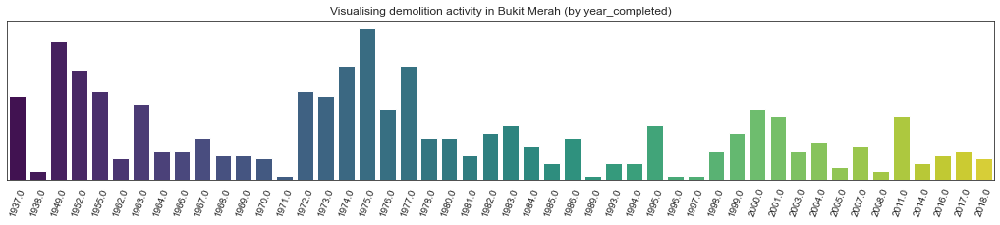

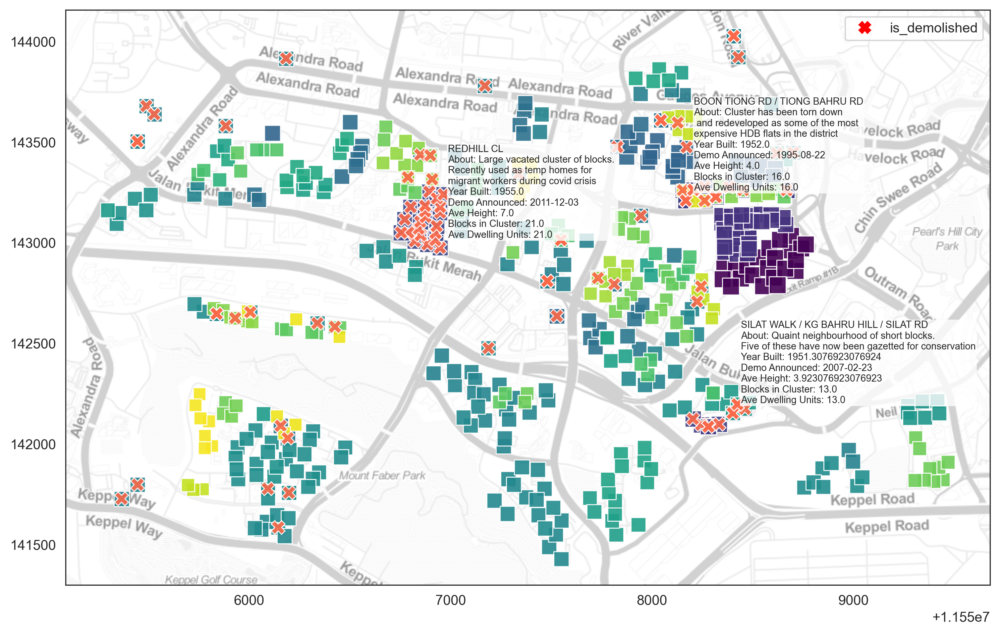

In [457]:
# <<CASE STUDY_BUKIT MERAH>>
district_comparison("Bukit Merah", "bm", all_blocks_new, "year_completed", 
                    hue="is_demolished", map_style =ctx.sources.ST_TONER_LITE, 
                    figsize=(12,10))

### 4.6 The Survivors
The government does not always raze an entire estate to the ground. Some blocks "survive" the wrecking ball even though they were part of the same estate and built in the same generation. Let's look at some of these "survivors" and see if we can learn what their survival instincts are. 

In [150]:
demo_blocks = blocks_pre1987[blocks_pre1987["is_demolished"]==1]

survivor_list =[]
num_of_blocks = blocks_pre1987.shape[0]
for block in range(num_of_blocks):
    survivor_list.append(0)
    match_score = 0
    block_loc = (blocks_pre1987["latitude"].iloc[block], blocks_pre1987["longitude"].iloc[block])    
    for demo_block in range(demo_blocks.shape[0]):
        # CONDITION: BLOCK STANDS
        block_standing = blocks_pre1987["is_demolished"].iloc[block] ==0
        # CONDITION: SAME STREET NAME
        same_street = blocks_pre1987["street"].iloc[block] == demo_blocks["street"].iloc[demo_block]
        # CONDITION: BUILT IN THE SAME YEAR
        demo_built_year = int(demo_blocks["year_completed"].iloc[demo_block])
        same_generation = int(blocks_pre1987["year_completed"].iloc[block]) == demo_built_year #in list(range(demo_built_year-2, demo_built_year+2))
        # CONDITION: SAME CARPARK CODE
        same_carpark = blocks_pre1987["cp_code"].iloc[demo_block] == demo_blocks["cp_code"].iloc[demo_block]
        # CONDITION: WITHIN 150metre
        demo_loc = (demo_blocks["latitude"].iloc[demo_block], demo_blocks["longitude"].iloc[demo_block])
        distance_btwn_locations = geopy.distance.geodesic(block_loc,demo_loc)
        within_150m = distance_btwn_locations.meters <= 150
        # IF STATEMENT WITH ALL ABOVE CONDITIONS
        if match_score == 0 and block_standing and same_generation and within_150m and (same_street or same_carpark) :
            survivor_list.pop()
            survivor_list.append(1)
            match_score += 1
            print("SURVIVOR: ", blocks_pre1987["blk_no"].iloc[block], blocks_pre1987["street"].iloc[block], "(", blocks_pre1987["year_completed"].iloc[block], ")")
            print("DEMOLISHED BLOCK: ", demo_blocks["blk_no"].iloc[demo_block], demo_blocks["street"].iloc[demo_block], "(", demo_blocks["year_completed"].iloc[demo_block], ")")
            print("DISTANCE: ", distance_btwn_locations.meters, "\n")
if len(survivor_list) == num_of_blocks:
    print("SCANNED: ", len(survivor_list), " / " ,num_of_blocks, " blocks")
    print("WE'VE CREATED A LIST OF ", sum(survivor_list), " SURVIVORS")
else:
    print("ERROR!!")

SURVIVOR:  46 jln bt ho swee ( 1964.0 )
DEMOLISHED BLOCK:  103 lower delta rd ( 1964.0 )
DISTANCE:  68.54801638983571 

SURVIVOR:  24 beo cres ( 1963.0 )
DEMOLISHED BLOCK:  54 nile rd ( 1963.0 )
DISTANCE:  145.58077765459893 

SURVIVOR:  40 beo cres ( 1963.0 )
DEMOLISHED BLOCK:  51 nile rd ( 1963.0 )
DISTANCE:  99.95957526059159 

SURVIVOR:  44 beo cres ( 1964.0 )
DEMOLISHED BLOCK:  103 lower delta rd ( 1964.0 )
DISTANCE:  62.63162677311141 

SURVIVOR:  42 beo cres ( 1964.0 )
DEMOLISHED BLOCK:  103 lower delta rd ( 1964.0 )
DISTANCE:  109.16105861151473 

SURVIVOR:  48 lower delta rd ( 1964.0 )
DEMOLISHED BLOCK:  103 lower delta rd ( 1964.0 )
DISTANCE:  91.78858905236233 

SURVIVOR:  53 lor 5 toa payoh ( 1967.0 )
DEMOLISHED BLOCK:  33 lor 5 toa payoh / lor 6 toa payoh ( 1967.0 )
DISTANCE:  104.80289013163117 

SURVIVOR:  128 lor 1 toa payoh ( 1969.0 )
DEMOLISHED BLOCK:  167 lor 1 toa payoh ( 1969.0 )
DISTANCE:  0.0 

SURVIVOR:  124 lor 1 toa payoh ( 1969.0 )
DEMOLISHED BLOCK:  167 lor 

SURVIVOR:  310 clementi ave 4 ( 1978.0 )
DEMOLISHED BLOCK:  311 clementi ave 4 ( 1978.0 )
DISTANCE:  137.46965775749769 

SURVIVOR:  315 clementi ave 4 ( 1978.0 )
DEMOLISHED BLOCK:  311 clementi ave 4 ( 1978.0 )
DISTANCE:  103.6855072105343 

SURVIVOR:  412 bedok nth ave 2 ( 1978.0 )
DEMOLISHED BLOCK:  83 bedok nth rd ( 1978.0 )
DISTANCE:  104.70473853060923 

SURVIVOR:  317 clementi ave 4 ( 1978.0 )
DEMOLISHED BLOCK:  312 clementi ave 4 ( 1978.0 )
DISTANCE:  129.44319335036383 

SURVIVOR:  316 clementi ave 4 ( 1978.0 )
DEMOLISHED BLOCK:  311 clementi ave 4 ( 1978.0 )
DISTANCE:  117.37694758362754 

SURVIVOR:  461 ang mo kio ave 10 ( 1979.0 )
DEMOLISHED BLOCK:  455 ang mo kio ave 10 ( 1979.0 )
DISTANCE:  86.63333167022871 

SURVIVOR:  462 ang mo kio ave 10 ( 1979.0 )
DEMOLISHED BLOCK:  455 ang mo kio ave 10 ( 1979.0 )
DISTANCE:  91.24685135751102 

SURVIVOR:  463 ang mo kio ave 10 ( 1979.0 )
DEMOLISHED BLOCK:  455 ang mo kio ave 10 ( 1979.0 )
DISTANCE:  117.16841306276226 

SURVIVOR:  

In [151]:
# CREATING A DF WITH ONLY SURVIVORS AND DEMOLISHED BLOCKS
survivor_blocks = blocks_pre1987.copy()
survivor_blocks["is_survivor"] = survivor_list
survived_demo = survivor_blocks[(survivor_blocks["is_survivor"]==1) | (survivor_blocks["is_demolished"]==1)].copy()

In [152]:
# DESCRIBING SURVIVORS
pd.set_option('display.max_columns', 22) 
survived_demo[survived_demo["is_survivor"]==1].describe()

,year_completed,max_floor_lvl,total_dwelling_units,1room_sold,2room_sold,3room_sold,4room_sold,5room_sold,exec_sold,other_sold,is_demolished,latitude,longitude,cp_decks,cp_gantry_height,dist_to_airfield,height_score_2020,density_500m,is_survivor
count,85.000000,85.000000,85.000000,85.0,85.000000,85.000000,85.000000,85.000000,85.000000,85.000000,85.0,85.000000,85.000000,85.000000,85.000000,85.000000,85.000000,85.000000,85.0
mean,1974.270588,13.835294,148.917647,0.0,1.870588,83.588235,24.788235,14.882353,0.247059,23.541176,0.0,1.312406,103.809115,3.400000,3.083647,10072.105882,-3.201647,53.070588,1.0
std,4.321563,6.208380,91.873776,0.0,12.558234,92.814369,46.170774,32.328821,0.924609,78.879890,0.0,0.022578,0.045297,4.522957,2.178557,3025.349531,6.144627,20.994210,0.0
min,1963.000000,2.000000,3.000000,0.0,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.0,1.273090,103.724111,0.000000,0.000000,4255.000000,-15.830000,16.000000,1.0
25%,1971.000000,10.000000,96.000000,0.0,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.0,1.303736,103.769573,0.000000,2.000000,7389.000000,-7.320000,37.000000,1.0
50%,1976.000000,13.000000,130.000000,0.0,0.000000,43.000000,0.000000,0.000000,0.000000,0.000000,0.0,1.311439,103.810144,0.000000,2.150000,10597.000000,-3.420000,53.000000,1.0
75%,1977.000000,19.000000,191.000000,0.0,0.000000,144.000000,22.000000,5.000000,0.000000,0.000000,0.0,1.328920,103.844627,7.000000,4.500000,12398.000000,0.870000,67.000000,1.0
max,1980.000000,25.000000,382.000000,0.0,111.000000,296.000000,168.000000,96.000000,5.000000,360.000000,0.0,1.367528,103.941467,13.000000,9.990000,14665.000000,11.940000,101.000000,1.0


In [153]:
# DESCRIBING DEMOS
pd.set_option('display.max_columns', 22) 
survived_demo[survived_demo["is_demolished"]==1].describe()

,year_completed,max_floor_lvl,total_dwelling_units,1room_sold,2room_sold,3room_sold,4room_sold,5room_sold,exec_sold,other_sold,is_demolished,latitude,longitude,cp_decks,cp_gantry_height,dist_to_airfield,height_score_2020,density_500m,is_survivor
count,391.000000,391.000000,391.000000,391.000000,391.000000,391.000000,391.000000,391.000000,391.000000,391.000000,391.0,391.000000,391.000000,391.000000,391.000000,391.000000,384.000000,391.000000,391.0
mean,1970.703325,11.099744,111.012788,1.278772,4.810742,76.979540,23.406650,3.209719,0.695652,0.631714,1.0,1.315685,103.809645,1.153453,2.339284,9914.764706,-4.025182,47.641944,0.0
std,8.989393,4.104753,55.762981,15.306661,10.865848,52.212088,40.349192,7.525479,2.477997,7.148062,0.0,0.034922,0.049506,3.104502,2.776002,3605.570699,4.480833,26.969397,0.0
min,1949.000000,2.000000,3.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,1.0,1.271782,103.704002,0.000000,0.000000,2057.000000,-17.810000,0.000000,0.0
25%,1963.000000,10.000000,87.000000,0.000000,0.000000,38.000000,0.000000,0.000000,0.000000,0.000000,1.0,1.289946,103.782690,0.000000,0.000000,6587.500000,-7.630000,26.000000,0.0
50%,1973.000000,11.000000,116.000000,0.000000,0.000000,83.000000,3.000000,0.000000,0.000000,0.000000,1.0,1.306407,103.811033,0.000000,2.000000,11002.000000,-2.935000,50.000000,0.0
75%,1977.000000,14.000000,143.000000,0.000000,2.000000,99.000000,44.000000,3.000000,0.000000,0.000000,1.0,1.330058,103.836288,0.000000,4.500000,13131.000000,-0.672500,64.000000,0.0
max,1986.000000,25.000000,374.000000,255.000000,115.000000,374.000000,256.000000,94.000000,15.000000,101.000000,1.0,1.441353,103.943593,12.000000,9.990000,15222.000000,7.200000,132.000000,0.0


In [154]:
# FUNCTION TO CREATE SEABORN DISTPLOTS WITH HUES 
def distplot_fig(data, x, hue=None, row=None, col=None, legend=True, hist=False, **kwargs):
    """A figure-level distribution plot with support for hue, col, row arguments."""
    bins = kwargs.pop('bins', None)
    if (bins is None) and hist: 
        # MAKE SURE THAT THE GROUPS HAVE EQUAL-SIZED BINS
        bins = np.histogram_bin_edges(data[x].dropna())
    ax = sns.FacetGrid(data, hue=hue, row=row, col=col)
    ax.map(sns.distplot, x, bins=bins, hist=hist, **kwargs)
    if legend and (hue is not None) and (hue not in [x, row, col]):
        ax.add_legend(title=hue)  

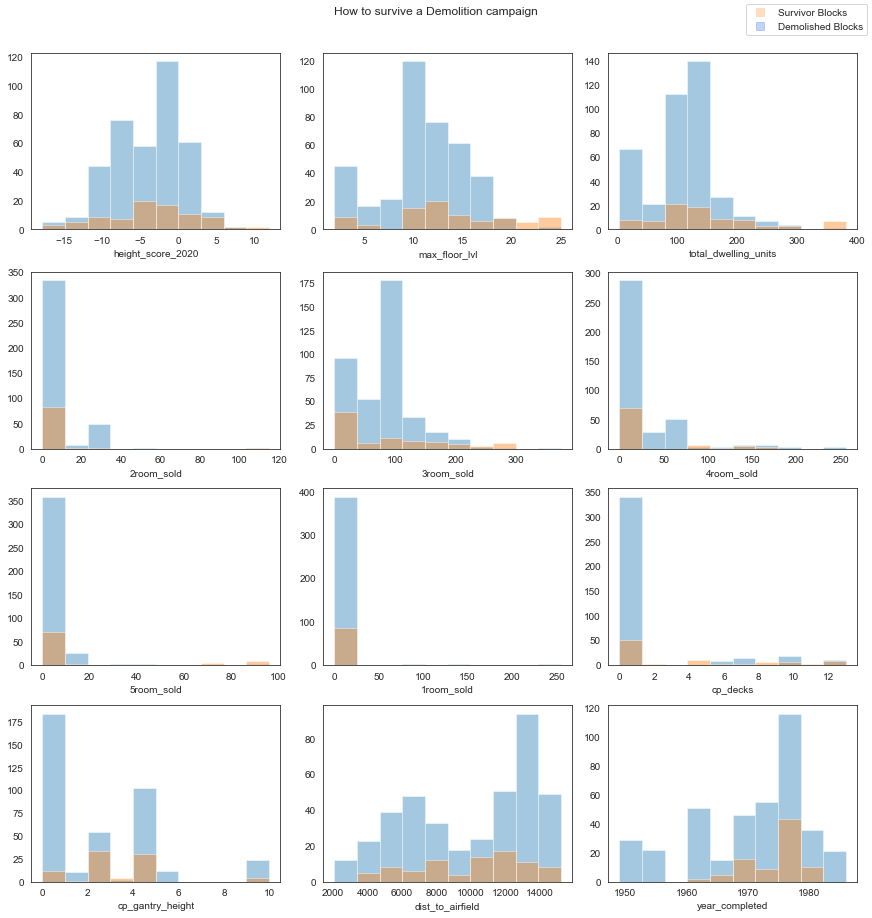

In [164]:
# ISOLATING FEATURES WE WANT TO EXPLORE
inspection_list = ['height_score_2020','max_floor_lvl','total_dwelling_units',
                   '2room_sold','3room_sold','4room_sold',
                   '5room_sold','1room_sold',#'latest_survival_date',
                   'cp_decks','cp_gantry_height',
                   'dist_to_airfield','year_completed','density_500m']

rows = round(len(inspection_list)/3)

fig, axes = plt.subplots(nrows=rows, ncols=3, figsize=(12, rows*3),constrained_layout=True)
axes = axes.ravel()
fig.suptitle('How to survive a Demolition campaign', y=1.05, fontsize=12)


for k, ax in enumerate(axes):
    blank =distplot_fig(data=survived_demo, x=inspection_list[k], hue='is_survivor', label=True, kde=False, hist=True, ax=ax)
    plt.close(blank)
    
# CUSTOM LEGEND
legend_elements=[
                 Line2D([0],[0],marker='s', color='peachpuff',alpha=0.9, 
                        label='Survivor Blocks',linestyle='', markersize=8),
                 Line2D([0],[0],marker='s', color='cornflowerblue',alpha=0.4, 
                        label='Demolished Blocks',linestyle='', markersize=8)
                 ]
fig.legend(handles=legend_elements, loc='upper right', fontsize=10);


### Survivor Instincts 
From the orange parts of our distribution plots, we can identify certain characteristics specific to blocks which survive a demolition.

- **High Height Scores (above 5)**

- **High Maximum Floor Levels (above 20 floors)**

- **High Total Dwelling Units (above 300)**

- **High numbers of 3room units (above 250)**

In [165]:
# IDENTIFYING ESTATES WITH SURVIVORS ABOVE 19 FLOORS
survivors_tall = survived_demo[survived_demo["is_survivor"]==1][survived_demo["max_floor_lvl"]>19]["street"].unique().tolist()
survivors_tall

/Users/samuelhe/opt/anaconda3/lib/python3.7/site-packages/geopandas/geodataframe.py:546: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  result = super(GeoDataFrame, self).__getitem__(key)


['lor 4 toa payoh',
 'bt merah view',
 'holland cl',
 'holland ave',
 'dover cres',
 'ghim moh rd',
 'sims dr',
 'telok blangah dr',
 "c'wealth ave west"]

In [167]:
# IDENTIFYING ESTATES WITH SURVIVORS WITH A HIGH HEIGHT SCORE
survivors_high_height_score = survived_demo[survived_demo["is_survivor"]==1][survived_demo["height_score_2020"]>5]["street"].unique().tolist()
survivors_high_height_score

['holland cl', 'holland ave', 'ghim moh rd', 'sims dr', "c'wealth ave west"]

In [168]:
# IDENTIFYING ESTATES WITH SURVIVORS WITH A HIGH TOTAL DWELLING UNITS
survivors_high_dwell = survived_demo[survived_demo["is_survivor"]==1][survived_demo["total_dwelling_units"]>=200]["street"].unique().tolist()
survivors_high_dwell 

['lower delta rd',
 'lor 5 toa payoh',
 'lor 1 toa payoh',
 'bt merah view',
 'holland cl',
 'holland ave',
 'ghim moh rd',
 'henderson rd',
 'new upp changi rd',
 'ang mo kio ave 10',
 'west coast rd']

In [173]:
pd.set_option('display.max_columns', 35) 
pd.set_option('display.max_colwidth', 15) 
# LET'S LOOK AT SURVIVORS IN ALL THE ESTATES ABOVE
#survived_demo[survived_demo["is_survivor"]==1][survived_demo["street"].isin(survive_estates)]
high_height_score = (survived_demo["height_score_2020"]>5) 
high_dwell = (survived_demo["total_dwelling_units"]>=200)
high_floors = (survived_demo["max_floor_lvl"]>19)
survived_demo[survived_demo["is_survivor"]==1][high_floors| high_dwell | high_height_score].sort_values(["max_floor_lvl", "total_dwelling_units"])

/Users/samuelhe/opt/anaconda3/lib/python3.7/site-packages/geopandas/geodataframe.py:546: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  result = super(GeoDataFrame, self).__getitem__(key)


,latest_survival_date,year_completed,blk_no,street,max_floor_lvl,bldg_contract_town,total_dwelling_units,1room_sold,2room_sold,3room_sold,4room_sold,5room_sold,exec_sold,other_sold,is_demolished,latitude,longitude,cp_code,cp_type,cp_system,cp_short_term,cp_free,cp_night,cp_decks,cp_gantry_height,cp_basement,geometry,dist_to_airfield,airfield,height_score_2020,density_500m,is_survivor
2192,2020-04-24,1979.0,701,west coast rd,12,cl,216.0,0.0,0.0,190.0,22.0,3.0,1.0,0.0,0,1.307612,103.761376,c34,surface car...,electronic ...,no,sun & ph fr...,no,0,4.50,n,POINT (1155...,10582,tengah air ...,-0.44,34,1
598,2020-04-24,1964.0,48,lower delta rd,12,bm,382.0,0.0,111.0,0.0,0.0,0.0,0.0,271.0,0,1.289443,103.826201,h18,multi-store...,electronic ...,whole day,sun & ph fr...,yes,6,2.15,n,POINT (1155...,12131,paya lebar ...,-5.00,54,1
2128,2020-04-24,1979.0,463,ang mo kio ...,13,amk,256.0,0.0,0.0,224.0,24.0,3.0,5.0,0.0,0,1.366948,103.857488,a87,surface car...,electronic ...,whole day,sun & ph fr...,yes,0,0.00,n,POINT (1156...,5646,seletar air...,0.02,66,1
2189,2020-04-24,1979.0,704,west coast rd,13,cl,258.0,0.0,0.0,228.0,24.0,1.0,5.0,0.0,0,1.306348,103.760538,c34,surface car...,electronic ...,no,sun & ph fr...,no,0,4.50,n,POINT (1155...,10647,tengah air ...,0.61,33,1
1221,2020-04-24,1976.0,16,ghim moh rd,14,qt,208.0,0.0,0.0,0.0,0.0,0.0,0.0,208.0,0,1.309638,103.787647,gm6b,multi-store...,electronic ...,whole day,sun & ph fr...,yes,7,2.15,n,POINT (1155...,12287,tengah air ...,-9.95,37,1
1341,2020-04-24,1976.0,19,ghim moh rd,14,qt,216.0,0.0,0.0,210.0,0.0,6.0,0.0,0.0,0,1.311439,103.788299,gm3,surface car...,electronic ...,whole day,sun & ph fr...,yes,0,0.00,n,POINT (1155...,12201,tengah air ...,-8.94,36,1
1421,2020-04-24,1978.0,57,new upp cha...,15,bd,238.0,0.0,0.0,238.0,0.0,0.0,0.0,0.0,0,1.322976,103.941467,b17,surface car...,electronic ...,whole day,sun & ph fr...,yes,0,4.50,n,POINT (1157...,5451,paya lebar ...,-1.20,46,1
720,2020-04-24,1969.0,128,lor 1 toa p...,16,tp,200.0,0.0,0.0,200.0,0.0,0.0,0.0,0.0,0,1.338217,103.844064,tpmg,multi-store...,electronic ...,whole day,sun & ph fr...,yes,5,2.15,n,POINT (1155...,7674,paya lebar ...,-3.81,64,1
1278,2020-04-24,1975.0,91,henderson rd,16,bm,360.0,0.0,0.0,0.0,0.0,0.0,0.0,360.0,0,1.287868,103.820465,hrm,multi-store...,electronic ...,whole day,sun & ph fr...,yes,9,2.15,n,POINT (1155...,12734,paya lebar ...,-0.94,62,1
1279,2020-04-24,1975.0,92,henderson rd,16,bm,360.0,0.0,0.0,0.0,0.0,0.0,0.0,360.0,0,1.287399,103.820444,hrm,multi-store...,electronic ...,whole day,sun & ph fr...,yes,9,2.15,n,POINT (1155...,12769,paya lebar ...,-0.57,67,1


### Additional characteristics of Survivor Blocks
From the dataframe above, we are able to spot some defining characteristics about our survivor blocks:

- **Point Blocks** -  25 floors, 96 5-room units. These are the characteristics of the survivors in dover crescent and ghim moh rd. This describes a point block - which has 4 units on every floor served by 2 elevators. It'll be worth while to check if there are other point blocks in our training data. 


- **"Mega Blocks"** - We're also seeing a trend of survivor blocks that have a high number of total dwelling units(tdu). 91-93 Henderson Road, for example has 360 units packed into 16 floors. The average tdu in this dataset is 114 units. 


- **Case Study: Ghim Moh Road** - The survivors in Ghim Moh Road fall into both these categories. It will be worth looking into this particular cluster to find out what the demolished blocks look like.


### 4.7 The Case of Ghim Moh

In [174]:
# <<GHIM MOH RD CASE STUDY>>
#COMPARING SURVIVORS TO DEMOLISHED BLOCKS IN GHIM MOH ROAD
survived_demo[survived_demo["street"]=="ghim moh rd"].sort_values("is_survivor")

,latest_survival_date,year_completed,blk_no,street,max_floor_lvl,bldg_contract_town,total_dwelling_units,1room_sold,2room_sold,3room_sold,4room_sold,5room_sold,exec_sold,other_sold,is_demolished,latitude,longitude,cp_code,cp_type,cp_system,cp_short_term,cp_free,cp_night,cp_decks,cp_gantry_height,cp_basement,geometry,dist_to_airfield,airfield,height_score_2020,density_500m,is_survivor
309,2006-12-08,1976.0,9,ghim moh rd,10,qt,257.0,0.0,0.0,235.0,20.0,2.0,0.0,0.0,1,1.309494,103.788725,gm6b,multi-store...,electronic ...,whole day,sun & ph fr...,yes,7,2.15,n,POINT (1155...,12384,tengah air ...,-12.35,40,0
310,2006-12-08,1976.0,10,ghim moh rd,10,qt,258.0,0.0,0.0,235.0,20.0,3.0,0.0,0.0,1,1.309494,103.788725,gm6b,multi-store...,electronic ...,whole day,sun & ph fr...,yes,7,2.15,n,POINT (1155...,12384,tengah air ...,-12.35,40,0
311,2006-12-08,1976.0,11,ghim moh rd,20,qt,76.0,0.0,0.0,0.0,76.0,0.0,0.0,0.0,1,1.309310,103.789686,gm6b,multi-store...,electronic ...,whole day,sun & ph fr...,yes,7,2.15,n,POINT (1155...,12475,tengah air ...,1.92,40,0
312,2006-12-08,1976.0,12,ghim moh rd,14,qt,138.0,0.0,0.0,0.0,138.0,0.0,0.0,0.0,1,1.311821,103.787326,gm6b,multi-store...,electronic ...,whole day,sun & ph fr...,yes,7,2.15,n,POINT (1155...,12093,tengah air ...,-8.13,31,0
313,2006-12-08,1976.0,9a,ghim moh rd,14,qt,138.0,0.0,0.0,0.0,138.0,0.0,0.0,0.0,1,1.312643,103.786943,gm6b,multi-store...,electronic ...,whole day,sun & ph fr...,yes,7,2.15,n,POINT (1155...,12000,tengah air ...,-7.50,28,0
314,2006-12-08,1976.0,12a,ghim moh rd,14,qt,139.0,0.0,0.0,0.0,139.0,0.0,0.0,0.0,1,1.311728,103.788078,gm6b,multi-store...,electronic ...,whole day,sun & ph fr...,yes,7,2.15,n,POINT (1155...,12161,tengah air ...,-8.46,35,0
1221,2020-04-24,1976.0,16,ghim moh rd,14,qt,208.0,0.0,0.0,0.0,0.0,0.0,0.0,208.0,0,1.309638,103.787647,gm6b,multi-store...,electronic ...,whole day,sun & ph fr...,yes,7,2.15,n,POINT (1155...,12287,tengah air ...,-9.95,37,1
1323,2020-04-24,1976.0,15,ghim moh rd,14,qt,156.0,0.0,0.0,0.0,156.0,0.0,0.0,0.0,0,1.309144,103.788420,gm6a,multi-store...,electronic ...,7am-7pm,sun & ph fr...,no,5,2.15,n,POINT (1155...,12386,tengah air ...,-8.64,42,1
1324,2020-04-24,1976.0,14,ghim moh rd,25,qt,96.0,0.0,0.0,0.0,0.0,96.0,0.0,0.0,0,1.308847,103.789147,gm6a,multi-store...,electronic ...,7am-7pm,sun & ph fr...,no,5,2.15,n,POINT (1155...,12467,tengah air ...,5.70,40,1
1325,2020-04-24,1976.0,13,ghim moh rd,25,qt,96.0,0.0,0.0,0.0,0.0,96.0,0.0,0.0,0,1.309707,103.789100,gm6a,multi-store...,electronic ...,7am-7pm,sun & ph fr...,no,5,2.15,n,POINT (1155...,12398,tengah air ...,4.98,41,1


In [286]:
# WE'VE SPOTTED AN ERROR. 21 GHIM MOH ROAD IS A FIVE STOREY BLOCK, NOT TEN. 
# ALL OTHER DETAILS ARE CORRECT
# IMPUTE NEW DATA FOR BLOCK 21 GHIM MOH ROAD
# PROPS TO EDGEPROP FOR THE DETAILS: https://www.edgeprop.sg/project/hdb/21-ghim-moh-road-14868
all_blocks_geo.loc[1466, "max_floor_lvl"]=4

In [287]:
# DEFINING A FUNCTION TO COMPARE A PARTICULAR FEATURE WITHIN A DISTRICT
def survivor_study(district_name, district_code, dataframe, 
                        comparison_feature, hue, map_style,
                        figsize):    
    
    # CREATING A DATAFRAME OF BLOCK COUNTS BY FEATURE
    district_blocks = dataframe[dataframe["bldg_contract_town"]==district_code]
    blocks_by_year = pd.DataFrame(district_blocks[comparison_feature].value_counts(ascending=False)).reset_index()
    blocks_by_year.columns=[comparison_feature, "count"]
    # CREATING A DATAFRAME WITH ONLY DEMOLISHED BLOCKS
    demo_only = district_blocks[district_blocks[hue]==0]
    survive_only = district_blocks[district_blocks[hue]==1]
#     # <<PLOT 1: BARPLOT>> 
#     g = plt.figure(figsize=(18,3))
#     plt.title("Visualising demolition activity in "+ district_name + " (by "+comparison_feature+")")
#     g = sns.barplot(comparison_feature, "count", data=blocks_by_year, palette="viridis")
#     plt.xticks(rotation=70);
#     g.set(yticks=[])
#     g.set(ylabel=None)
#     g.set(xlabel=None)

    # <<PLOT 2: GEO SCATTERPLOT>> 
    axis = plt.figure(figsize=figsize, dpi=300);

    # SURVIVOR BLOCKS 
    axis = sns.scatterplot(survive_only['geometry'].x, survive_only['geometry'].y, marker='o', 
                   sizes=(100, 120), palette="summer", alpha=0.9, legend=None, size=survive_only[hue],
                    hue=survive_only[hue]);
    # DEMOLISHED BLOCKS 
    sns.scatterplot(demo_only['geometry'].x, demo_only['geometry'].y, marker='X', 
                   sizes=(100, 120), palette="Reds", alpha=0.9, legend=None, size=demo_only[hue],
                    hue=demo_only[hue]);
    # ADDING BLOCK DETAILS
    for i in range(dataframe.shape[0]):
        plt.text(dataframe["geometry"].iloc[i].x +12, dataframe["geometry"].iloc[i].y, 
                 "[blk "+dataframe["blk_no"].iloc[i]+"]\nunits: "+str(dataframe["total_dwelling_units"].iloc[i])+"\nheight: "+str(dataframe["max_floor_lvl"].iloc[i]), 
                 fontsize=5, bbox=dict(boxstyle='square,pad=0.1', 
                                       fc='white', ec='none', alpha=0.4)) # 300m x offset added.


    # SETTING Y-AXIS LIMITS
    #axis.set_ylim([138000, 164000])
    axis.set_frame_on(False) 
    axis.set(yticks=[])
    axis.set(xticks=[])
    # CUSTOM LEGEND
    legend_elements=[
                     Line2D([0],[0],marker='X', color='red', label="Demolished",linestyle='', markersize=8),
                     Line2D([0],[1],marker='o', color='green', label="Survived",linestyle='', markersize=8),
                     ]

    plt.legend(handles=legend_elements, loc='upper right', fontsize=10)

    # ADDING A CONTEXTUAL BASE MAP 
    #ctx.add_basemap(axis,alpha=0.5)
    ctx.add_basemap(axis, url=map_style, alpha=0.4, cmap="gray") #CHOOSE TILE OPTION

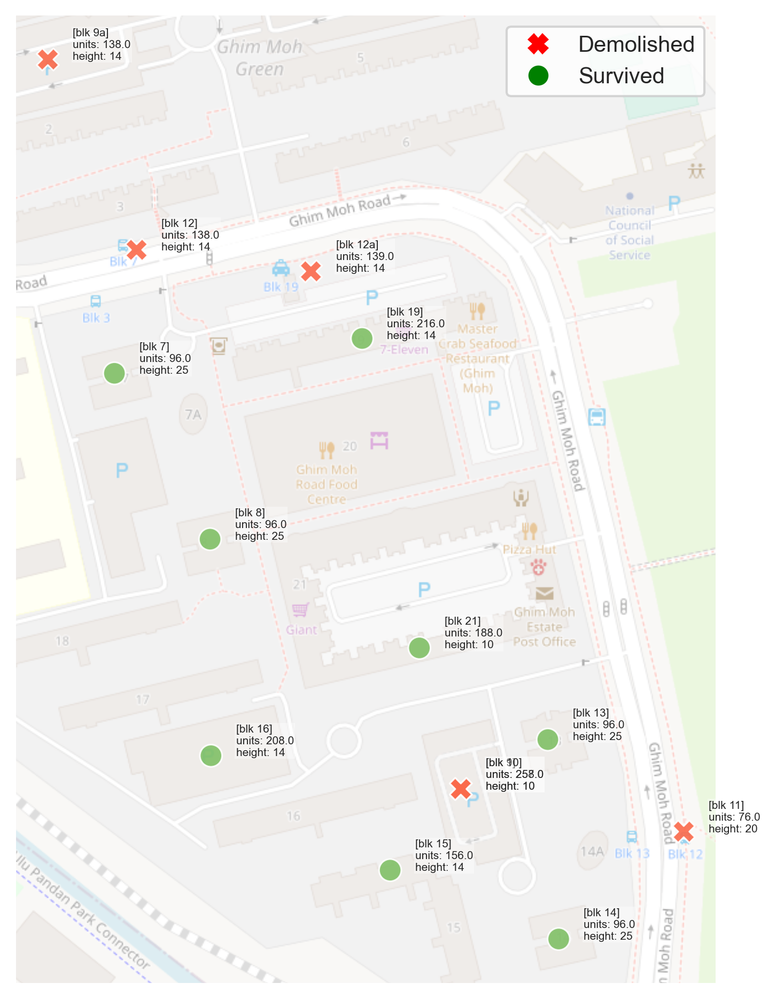

In [293]:
# <<CASE STUDY_GHIM MOH>>

ghim_moh_survived_demo = survived_demo[survived_demo["street"]=="ghim moh rd"]
survivor_study("Ghim Moh", "qt", ghim_moh_survived_demo, "max_floor_lvl", 
                    hue="is_survivor", map_style =ctx.sources.OSM_A,
                    figsize=(12,8))


### Case Study: Ghim Moh Road

- **Ghim Moh's demolished blocks** -  The demolished blocks have an average height of around 15 floors and about 168 total dwelling units. This is less total dwelling units than all the surviving blocks (not inclusive of point blocks). 


- **Engineered Feature: Units per floor** - With the lack of a "land area used" feature. Units per floor helps hint and the shape of a block. A Point block has $96 / 25 = 3.84$ units per floor, whereas a block like 15 Ghim Moh Road has $156 / 14 = 11.14$ units per floor. Lower units per floor hints at a block using less land area. 


- **Engineered Feature: Estimated Land Use** - A more accurate way to calculate land use might be to use the [HDB's indication](https://www.hdb.gov.sg/cs/infoweb/residential/buying-a-flat/resale/types-of-flats) of average floor area for certain flat types to obtain an estimated land area used by the block. 



### 4.8 Feature Engineering: Land Use Features

In [271]:
# CREATING A units_per_floor FEATURE
all_blocks_new["units_per_floor"] = all_blocks_new["total_dwelling_units"]/ all_blocks_new["max_floor_lvl"]
all_blocks_new["units_per_floor"].head()

0     6.0
1     6.0
2    12.0
3     6.0
4     6.0
Name: units_per_floor, dtype: float64

In [273]:
# CALCULATING TOTAL AREA IN SQM OCCUPIED BY DIFFERENT FLAT TYPES IN THE BLOCK
# WE OBTAINED THE ESTIMATED FLOOR AREAS FOR EACH FLAT TYPE FROM THE HDB WEBSITE
one_room_area = all_blocks_new['1room_sold']*33
two_room_area =all_blocks_new['2room_sold']*40.5
three_room_area =all_blocks_new['3room_sold']*62.5
four_room_area =all_blocks_new['4room_sold']*90
five_room_area =all_blocks_new['5room_sold']*115
exec_area =all_blocks_new['exec_sold']*130
# THE FLOOR AREA OF THE UNKNOWN FLATS ARE MEAN 
unknown_area = all_blocks_new['other_sold']*np.mean([33, 40.5, 62.5, 90, 115, 130])
total_area= one_room_area+ two_room_area + three_room_area+four_room_area+five_room_area+exec_area+ unknown_area

all_blocks_new['est_land_use']= total_area/ all_blocks_new['max_floor_lvl']
all_blocks_new['est_land_use'].tail()

10351    507.647059
10352    730.333333
10353    829.333333
10354    760.666667
10355    667.333333
Name: est_land_use, dtype: float64

### 4.9 The point about Point Blocks
Based on our data, point blocks seem to be the epitome of the demolition survivor. The average age of a point block is about 40 years old, yet none of them have be demolished. It's estimated land use is 430sqm, about 300 lesser than the mean.It also has an average height score of about 11.62, which means it has almost certainly hit its high potential (low incentive to build in its place).
In our earlier EDA, we've seen nine point blocks surviving a demolition campaign in their estate. We have only one known point block being demolished(111 Bukit Merah View). Its not huge numbers but that seems to be point at a 9 in 10 survivor rate. 

In [275]:
#LOOKING AT DETAILS OF POINT BLOCKS
high_floor = all_blocks_new["max_floor_lvl"]==25
dwell_96 = all_blocks_new["total_dwelling_units"]==96
#low_upf = all_blocks_new["units_per_floor"]<5
all_blocks_new[high_floor&dwell_96].describe()

,year_completed,max_floor_lvl,total_dwelling_units,1room_sold,2room_sold,3room_sold,4room_sold,5room_sold,exec_sold,other_sold,is_demolished,latitude,longitude,cp_decks,cp_gantry_height,dist_to_airfield,height_score_2020,density_500m,units_per_floor,est_land_use
count,205.000000,205.0,205.0,205.0,205.0,205.000000,205.000000,205.000000,205.000000,205.0,205.000000,205.000000,205.000000,205.000000,205.000000,205.000000,205.000000,205.000000,2.050000e+02,205.000000
mean,1980.414634,25.0,96.0,0.0,0.0,0.424390,11.712195,83.395122,0.468293,0.0,0.009756,1.328729,103.832941,2.180488,3.034000,7713.629268,9.414683,44.946341,3.840000e+00,429.277561
std,7.574388,0.0,0.0,0.0,0.0,2.713508,28.075355,29.674459,6.704931,0.0,0.098531,0.034757,0.063643,4.141091,2.271144,3114.240956,3.075440,20.472652,4.451763e-15,30.855247
min,1973.000000,25.0,96.0,0.0,0.0,0.000000,0.000000,0.000000,0.000000,0.0,0.000000,1.271747,103.716015,0.000000,0.000000,2896.000000,-1.680000,6.000000,3.840000e+00,319.200000
25%,1976.000000,25.0,96.0,0.0,0.0,0.000000,0.000000,96.000000,0.000000,0.0,0.000000,1.305370,103.771713,0.000000,1.900000,5588.000000,8.320000,28.000000,3.840000e+00,441.600000
50%,1978.000000,25.0,96.0,0.0,0.0,0.000000,0.000000,96.000000,0.000000,0.0,0.000000,1.324170,103.844481,0.000000,2.150000,6307.000000,9.900000,41.000000,3.840000e+00,441.600000
75%,1982.000000,25.0,96.0,0.0,0.0,0.000000,0.000000,96.000000,0.000000,0.0,0.000000,1.341828,103.867865,1.000000,4.500000,10493.000000,11.640000,59.000000,3.840000e+00,441.600000
max,2009.000000,25.0,96.0,0.0,0.0,24.000000,96.000000,96.000000,96.000000,0.0,1.000000,1.447608,103.942554,14.000000,9.990000,14685.000000,14.840000,121.000000,3.840000e+00,499.200000


In [276]:
# DESCRIBING OUR ENTIRE DATASET
all_blocks_new.describe()

,year_completed,max_floor_lvl,total_dwelling_units,1room_sold,2room_sold,3room_sold,4room_sold,5room_sold,exec_sold,other_sold,is_demolished,latitude,longitude,cp_decks,cp_gantry_height,dist_to_airfield,height_score_2020,density_500m,units_per_floor,est_land_use
count,10356.000000,10356.000000,10356.000000,10356.000000,10356.000000,10356.000000,10356.000000,10356.000000,10356.000000,10356.000000,10356.000000,10356.000000,10356.000000,10356.000000,10356.000000,10356.000000,10347.000000,10356.000000,10356.000000,10356.000000
mean,1990.701429,13.838837,106.861240,0.072905,2.481943,25.866261,41.595500,23.559965,6.276844,7.007822,0.037756,1.363984,103.839532,4.607860,2.767740,5269.593762,0.052406,64.453457,8.048603,706.287025
std,13.719888,6.027556,56.403521,3.893611,13.703100,50.155128,41.378274,31.088876,18.950425,40.547711,0.190615,0.042693,0.073177,5.382703,2.061992,2911.151425,5.100704,24.648620,3.946065,275.422378
min,1937.000000,2.000000,2.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,1.270380,103.685228,0.000000,0.000000,1427.000000,-18.180000,0.000000,0.500000,34.687500
25%,1983.000000,11.000000,78.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,1.335747,103.774584,0.000000,2.000000,3308.750000,-1.810000,46.000000,5.500000,531.492647
50%,1988.000000,13.000000,100.000000,0.000000,0.000000,0.000000,34.000000,1.000000,0.000000,0.000000,0.000000,1.361027,103.844499,0.000000,2.150000,4349.000000,0.210000,64.000000,7.384615,673.750000
75%,1999.000000,16.000000,130.000000,0.000000,0.000000,30.000000,65.000000,44.000000,0.000000,0.000000,0.000000,1.390534,103.897751,10.000000,4.500000,6249.250000,1.730000,83.000000,9.500000,833.392857
max,2019.000000,50.000000,584.000000,255.000000,225.000000,528.000000,316.000000,164.000000,135.000000,520.000000,1.000000,1.456658,103.987805,19.000000,9.990000,15222.000000,31.550000,134.000000,45.363636,3336.500000


In [277]:
# CREATING EMPTY LIST
point_block_list =[]
# FOR LOOP TO LOOP THROUGH ALL BLOCKS
for block in range(all_blocks_new.shape[0]):
    point_height = all_blocks_new["max_floor_lvl"].iloc[block]==25
    point_units = all_blocks_new["total_dwelling_units"].iloc[block]==96
    # APPEND 1 FOR A POINT BLOCK
    if point_height and point_units:
        point_block_list.append(1)
    # ALL OTHER BLOCKS GET A ZERO
    else: 
        point_block_list.append(0)
# IF ALL IS WELL, CREATE A NEW COLUMN
if sum(point_block_list) == all_blocks_new[high_floor&dwell_96].shape[0]:
    all_blocks_new["is_point_block"] = point_block_list

In [278]:
# CHECKING IF COLUMN IS CREATED
all_blocks_new["is_point_block"].sum()

205

---
### 4.10 The unreliability of Latlons

The decision to redevelop on a piece of land has everything to do with location(value of land, distance to the city centre). Yet, our latitude and longitude data might be a source of "confusion" for our model. 

For example, the model might interpret Queenstown as a hotbed for demolitions just because there have been many demolished blocks there. That should not be the case (In fact, the opposite should be true). 

We postulate that "distance_to_XXX" features might be fairer features for our model. Let's create some of them


### Engineered Feature: Distance to nearest train station
We do not have data for the value of land in our dataset. But we know that there that buyers place value in a block that has easy access to a train station. We have access to an Singapore MRT stations dataset that will help us create such a feature.


In [281]:
# READ IN THE MRT DATASET
mrt = pd.read_csv("../data/mrt_coords.csv")
mrt.columns = map(str.lower, mrt.columns)
mrt.head()

,objectid,stn_name,stn_no,x,y,latitude,longitude,color
0,12,ADMIRALTY M...,NS10,24402.1063,46918.1131,1.440585,103.800998,RED
1,16,ALJUNIED MR...,EW9,33518.6049,33190.0020,1.316433,103.882893,GREEN
2,33,ANG MO KIO ...,NS16,29807.2655,39105.7720,1.369933,103.849553,RED
3,81,BAKAU LRT S...,SE3,36026.0821,41113.8766,1.388093,103.905418,OTHERS
4,80,BANGKIT LRT...,BP9,21248.2460,40220.9693,1.380018,103.772667,OTHERS


In [282]:
# TRANSFORMING mrt INTO A GEOGRAPHIC DF
# CREATING A GEOMETRY COLUMN
geometry = [Point(xy) for xy in zip(mrt['longitude'], mrt['latitude'])]

# COORDINATE REFERENCE SYSTEM : WGS84
crs = {'init': 'epsg:4326'}

# CREATING A GEOGRAPHIC DF
mrt_geo = gpd.GeoDataFrame(mrt, crs=crs, geometry=geometry)

# CONVERTING OUR GEOMETRY COLUMN TO WEB MERCATOR EPSG3857...
# THE CONTEXTILY MAPS USE THIS
mrt_geo = mrt_geo.to_crs(epsg=3857).copy()

/Users/samuelhe/opt/anaconda3/lib/python3.7/site-packages/pyproj/crs/crs.py:53: FutureWarning: '+init=<authority>:<code>' syntax is deprecated. '<authority>:<code>' is the preferred initialization method. When making the change, be mindful of axis order changes: https://pyproj4.github.io/pyproj/stable/gotchas.html#axis-order-changes-in-proj-6
  return _prepare_from_string(" ".join(pjargs))


In [283]:
# <<CREATING A DISTANCE TO NEAREST DESTINATION LIST AND A NEAREST DESTINATION NAME LIST>>

# BEFORE START OF FUNCTION PLS DEFINE THESE EMPTY LISTS
nearest_destination = []
dist_to_nearest_destination = []
# PLS DEFINE THE NUM OF ITERATIONS
num_of_blocks= 1 #all_blocks.shape[0]

# CREATING A FUNCTION
# FUNCTION TAKES ONE BLOCK DATAFRAME, ONE DESTINATION DATAFRAME...
# ALSO THE NAME OF THE COL IN DESTINATION DF THAT CONTAINS THE NAME OF THE DESTINATION
def block_to_destination(block_df, destination_df, destination_name_col):
    for block in range(num_of_blocks):
        # CREATING A TUPLE FOR A BLOCK'S LOCATION
        block_lon = block_df["longitude"].iloc[block]
        block_lat = block_df["latitude"].iloc[block]
        block_location = (block_lat, block_lon)
        # EMPTY LISTS TO HOUSE OUR DISTANCES AND DESTINATION NAMES
        distance_list = []
        destination_list = []
        for place in range(destination_df.shape[0]):
            dest_lon = destination_df["longitude"].iloc[place]
            dest_lat = destination_df["latitude"].iloc[place]
            dest_location = (dest_lat, dest_lon)
            # MEASURING DISTANCE BETWEEN DESTINATION AND BLOCK
            distance_btwn_locations = geopy.distance.geodesic(block_location,dest_location)
            distance_list.append(distance_btwn_locations.meters)
            destination_list.append(destination_df[destination_name_col].iloc[place])
        match_score = 0
        for position, distance in enumerate(distance_list):
            if distance == min(distance_list) and match_score==0:
                dist_to_nearest_destination.append(round(distance))
                nearest_destination.append(destination_list[position])
                match_score += 1
                if block%1000==0:
                    print("PROGRESS: ", block+1, " / ", num_of_blocks )
                    print("ADDRESS: ", block_df["blk_no"].iloc[block], block_df["street"].iloc[block])
                    print("NEAREST ",destination_name_col, ": ", destination_list[position], "-", round(distance), " metres\n")
    print("\n" + "*"*40)
    print("COMPLETED: ", num_of_blocks, "blocks")
    print("DESTINATIONS APPENDED: ", len(nearest_destination))  
    print("NEAREST DISTANCE APPENDED: ", len(dist_to_nearest_destination))  
    print("*"*40)

In [284]:
# PREPPING EMPTY LISTS
nearest_destination = []
dist_to_nearest_destination = []
num_of_blocks= all_blocks_new.shape[0]
# CALLING THE DISTANCE FUNCTION ON OUR DATA SETS
block_to_destination(all_blocks_new, mrt_geo, "stn_name")

PROGRESS:  1  /  10356
ADDRESS:  2 boon tiong rd / tiong bahru rd
NEAREST  stn_name :  TIONG BAHRU MRT STATION - 198  metres

PROGRESS:  1001  /  10356
ADDRESS:  74 whampoa dr
NEAREST  stn_name :  BOON KENG MRT STATION - 733  metres

PROGRESS:  2001  /  10356
ADDRESS:  584 ang mo kio ave 3
NEAREST  stn_name :  ANG MO KIO MRT STATION - 447  metres

PROGRESS:  3001  /  10356
ADDRESS:  908 tampines ave 4
NEAREST  stn_name :  TAMPINES WEST MRT STATION - 557  metres

PROGRESS:  4001  /  10356
ADDRESS:  408 bt batok west ave 4
NEAREST  stn_name :  BUKIT GOMBAK MRT STATION - 1021  metres

PROGRESS:  5001  /  10356
ADDRESS:  460 tampines st 42
NEAREST  stn_name :  TAMPINES EAST MRT STATION - 237  metres

PROGRESS:  6001  /  10356
ADDRESS:  559 hougang st 51
NEAREST  stn_name :  BUANGKOK MRT STATION - 510  metres

PROGRESS:  7001  /  10356
ADDRESS:  786 choa chu kang dr
NEAREST  stn_name :  YEW TEE MRT STATION - 290  metres

PROGRESS:  8001  /  10356
ADDRESS:  104b depot rd
NEAREST  stn_name : 

In [294]:
# CREATING OUR NEW ENGINEERED FEATURES
all_blocks_new["nearest_train_stn"] = nearest_destination
all_blocks_new["dist_to_train_stn"] = dist_to_nearest_destination

### Engineered Feature: Distance to city center
It'll be wortwhile to see how far a location is to the central business district. We'll take the latlon position of Raffles Place MRT as the city centre.

In [295]:
raffles_geo = mrt_geo[mrt_geo["stn_name"].str.contains("RAFFLES")].head(1)

raffles_geo

,objectid,stn_name,stn_no,x,y,latitude,longitude,color,geometry
133,186,RAFFLES PLA...,EW14,30019.1805,29617.6126,1.284126,103.851457,GREEN,POINT (1156...


In [296]:
# PREPPING EMPTY LISTS
nearest_destination = []
dist_to_nearest_destination = []
num_of_blocks= all_blocks_new.shape[0]
# CALLING THE DISTANCE FUNCTION ON OUR DATA SETS
block_to_destination(all_blocks_new, raffles_geo, "stn_name")

PROGRESS:  1  /  10356
ADDRESS:  2 boon tiong rd / tiong bahru rd
NEAREST  stn_name :  RAFFLES PLACE MRT STATION - 2535  metres

PROGRESS:  1001  /  10356
ADDRESS:  74 whampoa dr
NEAREST  stn_name :  RAFFLES PLACE MRT STATION - 4543  metres

PROGRESS:  2001  /  10356
ADDRESS:  584 ang mo kio ave 3
NEAREST  stn_name :  RAFFLES PLACE MRT STATION - 9577  metres

PROGRESS:  3001  /  10356
ADDRESS:  908 tampines ave 4
NEAREST  stn_name :  RAFFLES PLACE MRT STATION - 12175  metres

PROGRESS:  4001  /  10356
ADDRESS:  408 bt batok west ave 4
NEAREST  stn_name :  RAFFLES PLACE MRT STATION - 14833  metres

PROGRESS:  5001  /  10356
ADDRESS:  460 tampines st 42
NEAREST  stn_name :  RAFFLES PLACE MRT STATION - 14145  metres

PROGRESS:  6001  /  10356
ADDRESS:  559 hougang st 51
NEAREST  stn_name :  RAFFLES PLACE MRT STATION - 11418  metres

PROGRESS:  7001  /  10356
ADDRESS:  786 choa chu kang dr
NEAREST  stn_name :  RAFFLES PLACE MRT STATION - 16799  metres

PROGRESS:  8001  /  10356
ADDRESS:  1

In [297]:
# CREATING OUR NEW ENGINEERED FEATURE
all_blocks_new["dist_to_city_centre"] = dist_to_nearest_destination

In [298]:
# CHECKING IF OUR COLUMNS ARE IN TACT
all_blocks_new.head(2)

,latest_survival_date,year_completed,blk_no,street,max_floor_lvl,bldg_contract_town,total_dwelling_units,1room_sold,2room_sold,3room_sold,4room_sold,5room_sold,exec_sold,other_sold,is_demolished,latitude,longitude,...,cp_short_term,cp_free,cp_night,cp_decks,cp_gantry_height,cp_basement,geometry,dist_to_airfield,airfield,height_score_2020,density_500m,units_per_floor,est_land_use,is_point_block,nearest_train_stn,dist_to_train_stn,dist_to_city_centre
0,1995-08-22,1952.0,2,boon tiong ...,4,bm,24.0,0.0,0.0,24.0,0.0,0.0,0.0,0.0,1,1.286366,103.82879,...,whole day,sun & ph fr...,yes,0,0.0,n,POINT (1155...,12139,paya lebar ...,-10.38,125,6.0,375.0,0,TIONG BAHRU...,198,2535
1,1995-08-22,1952.0,16,boon tiong ...,4,bm,24.0,0.0,0.0,24.0,0.0,0.0,0.0,0.0,1,1.286987,103.82963,...,whole day,sun & ph fr...,yes,0,0.0,n,POINT (1155...,12024,paya lebar ...,-8.93,126,6.0,375.0,0,TIONG BAHRU...,303,2450


### Conclusion:
We've built quite a number of features. We're ready to model!

In [299]:
# SAVING TO CSV
#all_blocks_new.to_csv("../data/all_blocks_23_apr_2am.csv", index=False)